In [1]:
from __future__ import print_function
%matplotlib inline
import os
import random
import torch
from torch import nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm import tqdm

mannualSeed = 999

random.seed(mannualSeed)
torch.manual_seed(mannualSeed)

In [15]:
dataRoot = "./"
workers = 12
batchSize = 2560
imageSize = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
numEpochs = 500
lr = 0.000002
beta1 = 0.5
ngpu = 1

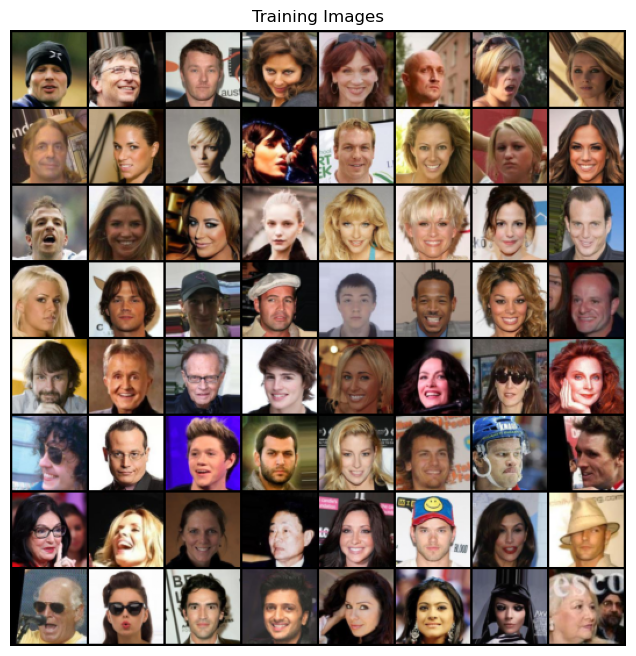

In [3]:
dataset = dset.ImageFolder(root=dataRoot,
                           transform=transforms.Compose([
                               transforms.Resize(imageSize),
                               transforms.CenterCrop(imageSize),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batchSize,shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

realBatch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(realBatch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
def weightsInit(m):
    className = m.__class__.__name__
    if className.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif className.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, input):
        return self.main(input)

In [6]:
netGenerator = Generator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netGenerator = nn.DataParallel(netGenerator, list(range(ngpu)))

In [7]:
netGenerator.apply(weightsInit)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    def forward(self, input):
        return self.main(input) 

In [9]:
netDiscriminator = Discriminator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netDiscriminator = nn.DataParallel(netDiscriminator, list(range(ngpu)))
netDiscriminator.apply(weightsInit)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [10]:
criteria = nn.BCELoss()
fixedNoise = torch.randn(64, nz, 1, 1, device=device)

realLabel = 1
fakeLabel = 0

optimizerGenerator = optim.Adam(netGenerator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerDiscriminator = optim.Adam(netDiscriminator.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
netDiscriminator.load_state_dict(torch.load("./discriminatorModel"))
netGenerator.load_state_dict(torch.load("./generatorModel"))

<All keys matched successfully>

In [16]:
imgList = []
generatorLosses = []
discriminatorLosses = []
iters = 0
for epoch in tqdm(range(numEpochs)):
    for i, data in enumerate(dataloader, 0):
        netDiscriminator.zero_grad()
        realCpu = data[0].to(device)
        bSize = realCpu.size(0)
        label = torch.full((bSize,), realLabel, device=device, dtype=torch.float)
        output = netDiscriminator(realCpu).view(-1)
        errDiscriminatorReal = criteria(output, label)
        errDiscriminatorReal.backward()
        disciminatorX = output.mean().item()
        noise = torch.randn(bSize, nz, 1, 1, device=device)
        fake = netGenerator(noise)
        label.fill_(fakeLabel)
        output = netDiscriminator(fake.detach()).view(-1)
        errorDiscriminatorFake = criteria(output, label)
        errorDiscriminatorFake.backward()
        discriminatorGeneratorZ1 = output.mean().item()
        errorDiscriminator = errDiscriminatorReal + errorDiscriminatorFake
        optimizerDiscriminator.step()
        netGenerator.zero_grad()
        label.fill_(realLabel)
        output = netDiscriminator(fake).view(-1)
        errorGenerator = criteria(output, label)
        errorGenerator.backward()
        discriminatorGeneratorZ2 = output.mean().item()
        optimizerGenerator.step()
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f' % (epoch, numEpochs, i, len(dataloader), errorDiscriminator.item(), errorGenerator.item(), disciminatorX, discriminatorGeneratorZ1, discriminatorGeneratorZ2))
        generatorLosses.append(errorGenerator.item())
        discriminatorLosses.append(errorDiscriminator.item())
        if (iters % 500 == 0) or ((epoch == numEpochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netGenerator(fixedNoise).detach().cpu()
            imgList.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

  0%|          | 0/500 [00:00<?, ?it/s]

[0/500][0/80]	Loss_D: 0.1070	Loss_G: 4.5645	D(x): 0.9648	D(G(z)): 0.0611 / 0.0260
[0/500][50/80]	Loss_D: 0.0557	Loss_G: 4.9450	D(x): 0.9705	D(G(z)): 0.0223 / 0.0193


  0%|          | 1/500 [00:44<6:09:29, 44.43s/it]

[1/500][0/80]	Loss_D: 0.3692	Loss_G: 2.9611	D(x): 0.8129	D(G(z)): 0.1021 / 0.1119
[1/500][50/80]	Loss_D: 0.0650	Loss_G: 4.9661	D(x): 0.9624	D(G(z)): 0.0225 / 0.0186


  0%|          | 2/500 [01:29<6:11:15, 44.73s/it]

[2/500][0/80]	Loss_D: 0.0574	Loss_G: 5.2149	D(x): 0.9789	D(G(z)): 0.0332 / 0.0140
[2/500][50/80]	Loss_D: 0.3129	Loss_G: 3.4356	D(x): 0.8941	D(G(z)): 0.1479 / 0.0687


  1%|          | 3/500 [02:14<6:11:03, 44.80s/it]

[3/500][0/80]	Loss_D: 0.1082	Loss_G: 5.0899	D(x): 0.9686	D(G(z)): 0.0655 / 0.0167
[3/500][50/80]	Loss_D: 4.5463	Loss_G: 1.1033	D(x): 0.0395	D(G(z)): 0.0002 / 0.4878


  1%|          | 4/500 [02:59<6:10:25, 44.81s/it]

[4/500][0/80]	Loss_D: 0.1002	Loss_G: 4.5306	D(x): 0.9698	D(G(z)): 0.0582 / 0.0278
[4/500][50/80]	Loss_D: 0.2767	Loss_G: 3.0378	D(x): 0.8850	D(G(z)): 0.1150 / 0.1033


  1%|          | 5/500 [03:43<6:07:48, 44.58s/it]

[5/500][0/80]	Loss_D: 0.0686	Loss_G: 5.0928	D(x): 0.9713	D(G(z)): 0.0335 / 0.0176
[5/500][50/80]	Loss_D: 0.2165	Loss_G: 4.6586	D(x): 0.9389	D(G(z)): 0.1157 / 0.0272


  1%|          | 6/500 [04:27<6:06:04, 44.46s/it]

[6/500][0/80]	Loss_D: 0.0681	Loss_G: 5.6907	D(x): 0.9883	D(G(z)): 0.0495 / 0.0100
[6/500][50/80]	Loss_D: 1.1144	Loss_G: 9.3915	D(x): 0.9967	D(G(z)): 0.5535 / 0.0003


  1%|▏         | 7/500 [05:11<6:04:06, 44.31s/it]

[7/500][0/80]	Loss_D: 0.1257	Loss_G: 4.7322	D(x): 0.9677	D(G(z)): 0.0771 / 0.0241
[7/500][50/80]	Loss_D: 0.0630	Loss_G: 4.8482	D(x): 0.9713	D(G(z)): 0.0293 / 0.0215


  2%|▏         | 8/500 [05:55<6:02:29, 44.21s/it]

[8/500][0/80]	Loss_D: 0.0639	Loss_G: 5.5907	D(x): 0.9786	D(G(z)): 0.0376 / 0.0105
[8/500][50/80]	Loss_D: 0.1937	Loss_G: 4.4252	D(x): 0.9518	D(G(z)): 0.1176 / 0.0285


  2%|▏         | 9/500 [06:39<6:00:50, 44.09s/it]

[9/500][0/80]	Loss_D: 0.0468	Loss_G: 5.4495	D(x): 0.9756	D(G(z)): 0.0191 / 0.0124
[9/500][50/80]	Loss_D: 0.4485	Loss_G: 3.2387	D(x): 0.8427	D(G(z)): 0.1875 / 0.0788


  2%|▏         | 10/500 [07:23<5:59:36, 44.03s/it]

[10/500][0/80]	Loss_D: 0.2117	Loss_G: 4.7922	D(x): 0.9487	D(G(z)): 0.1244 / 0.0210
[10/500][50/80]	Loss_D: 0.4629	Loss_G: 3.5650	D(x): 0.8546	D(G(z)): 0.2055 / 0.0656


  2%|▏         | 11/500 [08:07<6:00:04, 44.18s/it]

[11/500][0/80]	Loss_D: 0.1296	Loss_G: 4.5113	D(x): 0.9326	D(G(z)): 0.0432 / 0.0307
[11/500][50/80]	Loss_D: 0.0706	Loss_G: 4.4170	D(x): 0.9606	D(G(z)): 0.0248 / 0.0316


  2%|▏         | 12/500 [08:51<5:59:19, 44.18s/it]

[12/500][0/80]	Loss_D: 0.1774	Loss_G: 4.3806	D(x): 0.9364	D(G(z)): 0.0911 / 0.0294
[12/500][50/80]	Loss_D: 0.0510	Loss_G: 4.9951	D(x): 0.9791	D(G(z)): 0.0268 / 0.0183


  3%|▎         | 13/500 [09:34<5:55:50, 43.84s/it]

[13/500][0/80]	Loss_D: 0.4025	Loss_G: 3.3796	D(x): 0.8704	D(G(z)): 0.1866 / 0.0711
[13/500][50/80]	Loss_D: 0.0590	Loss_G: 5.6537	D(x): 0.9733	D(G(z)): 0.0272 / 0.0107


  3%|▎         | 14/500 [10:18<5:53:49, 43.68s/it]

[14/500][0/80]	Loss_D: 0.5823	Loss_G: 4.4405	D(x): 0.9179	D(G(z)): 0.3086 / 0.0328
[14/500][50/80]	Loss_D: 0.0520	Loss_G: 5.6715	D(x): 0.9804	D(G(z)): 0.0283 / 0.0112


  3%|▎         | 15/500 [11:01<5:51:33, 43.49s/it]

[15/500][0/80]	Loss_D: 0.5132	Loss_G: 2.7619	D(x): 0.7063	D(G(z)): 0.0673 / 0.1463
[15/500][50/80]	Loss_D: 0.0628	Loss_G: 5.2471	D(x): 0.9639	D(G(z)): 0.0209 / 0.0168


  3%|▎         | 16/500 [11:44<5:50:47, 43.49s/it]

[16/500][0/80]	Loss_D: 0.7162	Loss_G: 3.2838	D(x): 0.9586	D(G(z)): 0.4056 / 0.0843
[16/500][50/80]	Loss_D: 2.6374	Loss_G: 1.2336	D(x): 0.1437	D(G(z)): 0.0028 / 0.4301


  3%|▎         | 17/500 [12:30<5:55:51, 44.20s/it]

[17/500][0/80]	Loss_D: 0.0600	Loss_G: 5.4537	D(x): 0.9814	D(G(z)): 0.0338 / 0.0132
[17/500][50/80]	Loss_D: 0.3355	Loss_G: 3.3277	D(x): 0.8138	D(G(z)): 0.0731 / 0.0847


  4%|▎         | 18/500 [13:15<5:57:42, 44.53s/it]

[18/500][0/80]	Loss_D: 0.0510	Loss_G: 5.5840	D(x): 0.9834	D(G(z)): 0.0307 / 0.0113
[18/500][50/80]	Loss_D: 0.2577	Loss_G: 4.1611	D(x): 0.9385	D(G(z)): 0.1515 / 0.0362


  4%|▍         | 19/500 [14:01<5:59:24, 44.83s/it]

[19/500][0/80]	Loss_D: 0.1371	Loss_G: 7.7785	D(x): 0.9938	D(G(z)): 0.1074 / 0.0013
[19/500][50/80]	Loss_D: 0.0780	Loss_G: 4.7679	D(x): 0.9635	D(G(z)): 0.0315 / 0.0240


  4%|▍         | 20/500 [14:47<6:00:27, 45.06s/it]

[20/500][0/80]	Loss_D: 0.0634	Loss_G: 5.6545	D(x): 0.9819	D(G(z)): 0.0395 / 0.0101
[20/500][50/80]	Loss_D: 0.0705	Loss_G: 4.2574	D(x): 0.9624	D(G(z)): 0.0269 / 0.0363


  4%|▍         | 21/500 [15:32<5:59:55, 45.08s/it]

[21/500][0/80]	Loss_D: 0.4655	Loss_G: 2.9181	D(x): 0.8213	D(G(z)): 0.1755 / 0.1106
[21/500][50/80]	Loss_D: 0.1399	Loss_G: 5.8587	D(x): 0.9927	D(G(z)): 0.1086 / 0.0083


  4%|▍         | 22/500 [16:16<5:57:00, 44.81s/it]

[22/500][0/80]	Loss_D: 0.8280	Loss_G: 11.0978	D(x): 0.9996	D(G(z)): 0.4625 / 0.0001
[22/500][50/80]	Loss_D: 0.0695	Loss_G: 5.2762	D(x): 0.9739	D(G(z)): 0.0374 / 0.0149


  5%|▍         | 23/500 [17:00<5:54:59, 44.65s/it]

[23/500][0/80]	Loss_D: 0.1407	Loss_G: 7.7754	D(x): 0.9895	D(G(z)): 0.1063 / 0.0014
[23/500][50/80]	Loss_D: 0.1097	Loss_G: 4.2717	D(x): 0.9541	D(G(z)): 0.0514 / 0.0354


  5%|▍         | 24/500 [17:44<5:53:15, 44.53s/it]

[24/500][0/80]	Loss_D: 0.0842	Loss_G: 7.5952	D(x): 0.9929	D(G(z)): 0.0665 / 0.0015
[24/500][50/80]	Loss_D: 0.8240	Loss_G: 3.6281	D(x): 0.9766	D(G(z)): 0.4493 / 0.0646


  5%|▌         | 25/500 [18:29<5:52:04, 44.47s/it]

[25/500][0/80]	Loss_D: 0.0913	Loss_G: 5.6203	D(x): 0.9811	D(G(z)): 0.0629 / 0.0101
[25/500][50/80]	Loss_D: 0.0538	Loss_G: 5.1386	D(x): 0.9791	D(G(z)): 0.0279 / 0.0163


  5%|▌         | 26/500 [19:12<5:48:39, 44.13s/it]

[26/500][0/80]	Loss_D: 0.0609	Loss_G: 4.8999	D(x): 0.9754	D(G(z)): 0.0325 / 0.0191
[26/500][50/80]	Loss_D: 0.1596	Loss_G: 4.2323	D(x): 0.9483	D(G(z)): 0.0868 / 0.0342


  5%|▌         | 27/500 [19:57<5:48:35, 44.22s/it]

[27/500][0/80]	Loss_D: 0.0447	Loss_G: 4.7420	D(x): 0.9859	D(G(z)): 0.0280 / 0.0234
[27/500][50/80]	Loss_D: 0.2777	Loss_G: 4.2734	D(x): 0.9470	D(G(z)): 0.1704 / 0.0327


  6%|▌         | 28/500 [20:41<5:49:03, 44.37s/it]

[28/500][0/80]	Loss_D: 0.0637	Loss_G: 4.4407	D(x): 0.9682	D(G(z)): 0.0264 / 0.0317
[28/500][50/80]	Loss_D: 0.1773	Loss_G: 3.9110	D(x): 0.9367	D(G(z)): 0.0916 / 0.0448


  6%|▌         | 29/500 [21:26<5:50:19, 44.63s/it]

[29/500][0/80]	Loss_D: 0.4901	Loss_G: 1.5929	D(x): 0.9053	D(G(z)): 0.2543 / 0.3286
[29/500][50/80]	Loss_D: 0.2279	Loss_G: 4.4615	D(x): 0.9379	D(G(z)): 0.1285 / 0.0282


  6%|▌         | 30/500 [22:12<5:50:42, 44.77s/it]

[30/500][0/80]	Loss_D: 0.0703	Loss_G: 5.7603	D(x): 0.9888	D(G(z)): 0.0521 / 0.0093
[30/500][50/80]	Loss_D: 0.0628	Loss_G: 5.1218	D(x): 0.9754	D(G(z)): 0.0340 / 0.0166


  6%|▌         | 31/500 [22:56<5:50:13, 44.80s/it]

[31/500][0/80]	Loss_D: 0.3543	Loss_G: 2.9803	D(x): 0.8213	D(G(z)): 0.1024 / 0.1040
[31/500][50/80]	Loss_D: 0.0684	Loss_G: 4.6312	D(x): 0.9576	D(G(z)): 0.0191 / 0.0267


  6%|▋         | 32/500 [23:41<5:48:12, 44.64s/it]

[32/500][0/80]	Loss_D: 0.2055	Loss_G: 4.2149	D(x): 0.9239	D(G(z)): 0.0985 / 0.0344
[32/500][50/80]	Loss_D: 0.6936	Loss_G: 3.1214	D(x): 0.8339	D(G(z)): 0.3124 / 0.0952


  7%|▋         | 33/500 [24:25<5:46:56, 44.58s/it]

[33/500][0/80]	Loss_D: 0.3828	Loss_G: 4.4037	D(x): 0.9194	D(G(z)): 0.2106 / 0.0311
[33/500][50/80]	Loss_D: 0.0603	Loss_G: 4.8894	D(x): 0.9748	D(G(z)): 0.0309 / 0.0201


  7%|▋         | 34/500 [25:10<5:46:22, 44.60s/it]

[34/500][0/80]	Loss_D: 1.0810	Loss_G: 12.2243	D(x): 0.9995	D(G(z)): 0.5360 / 0.0000
[34/500][50/80]	Loss_D: 0.0607	Loss_G: 4.9962	D(x): 0.9805	D(G(z)): 0.0361 / 0.0186


  7%|▋         | 35/500 [25:54<5:44:42, 44.48s/it]

[35/500][0/80]	Loss_D: 0.5409	Loss_G: 4.1085	D(x): 0.8786	D(G(z)): 0.2653 / 0.0438
[35/500][50/80]	Loss_D: 0.4646	Loss_G: 2.5901	D(x): 0.7900	D(G(z)): 0.1452 / 0.1373


  7%|▋         | 36/500 [26:38<5:43:26, 44.41s/it]

[36/500][0/80]	Loss_D: 0.0767	Loss_G: 5.3875	D(x): 0.9832	D(G(z)): 0.0515 / 0.0132
[36/500][50/80]	Loss_D: 0.0661	Loss_G: 5.2298	D(x): 0.9787	D(G(z)): 0.0398 / 0.0145


  7%|▋         | 37/500 [27:23<5:42:23, 44.37s/it]

[37/500][0/80]	Loss_D: 0.4668	Loss_G: 2.7967	D(x): 0.8236	D(G(z)): 0.1890 / 0.1164
[37/500][50/80]	Loss_D: 0.0679	Loss_G: 5.0182	D(x): 0.9741	D(G(z)): 0.0370 / 0.0184


  8%|▊         | 38/500 [28:07<5:41:26, 44.34s/it]

[38/500][0/80]	Loss_D: 0.4402	Loss_G: 3.6694	D(x): 0.9295	D(G(z)): 0.2502 / 0.0625
[38/500][50/80]	Loss_D: 0.0595	Loss_G: 4.8076	D(x): 0.9604	D(G(z)): 0.0147 / 0.0229


  8%|▊         | 39/500 [28:51<5:40:40, 44.34s/it]

[39/500][0/80]	Loss_D: 0.2709	Loss_G: 3.2115	D(x): 0.8738	D(G(z)): 0.1006 / 0.0858
[39/500][50/80]	Loss_D: 0.3840	Loss_G: 2.8724	D(x): 0.8456	D(G(z)): 0.1467 / 0.1172


  8%|▊         | 40/500 [29:35<5:39:18, 44.26s/it]

[40/500][0/80]	Loss_D: 0.0464	Loss_G: 5.2636	D(x): 0.9725	D(G(z)): 0.0154 / 0.0157
[40/500][50/80]	Loss_D: 2.9130	Loss_G: 1.8197	D(x): 0.1434	D(G(z)): 0.0022 / 0.3477


  8%|▊         | 41/500 [30:18<5:35:56, 43.91s/it]

[41/500][0/80]	Loss_D: 0.1555	Loss_G: 4.2761	D(x): 0.9425	D(G(z)): 0.0785 / 0.0336
[41/500][50/80]	Loss_D: 0.0296	Loss_G: 6.1665	D(x): 0.9948	D(G(z)): 0.0225 / 0.0066


  8%|▊         | 42/500 [31:02<5:34:35, 43.83s/it]

[42/500][0/80]	Loss_D: 0.0146	Loss_G: 6.6007	D(x): 0.9979	D(G(z)): 0.0119 / 0.0042
[42/500][50/80]	Loss_D: 0.0139	Loss_G: 8.6625	D(x): 0.9988	D(G(z)): 0.0120 / 0.0008


  9%|▊         | 43/500 [31:46<5:33:59, 43.85s/it]

[43/500][0/80]	Loss_D: 0.0130	Loss_G: 10.5058	D(x): 0.9993	D(G(z)): 0.0118 / 0.0002
[43/500][50/80]	Loss_D: 0.0111	Loss_G: 9.7516	D(x): 0.9990	D(G(z)): 0.0095 / 0.0003


  9%|▉         | 44/500 [32:31<5:36:31, 44.28s/it]

[44/500][0/80]	Loss_D: 0.0043	Loss_G: 10.0797	D(x): 0.9996	D(G(z)): 0.0039 / 0.0002
[44/500][50/80]	Loss_D: 0.0047	Loss_G: 11.3177	D(x): 0.9988	D(G(z)): 0.0026 / 0.0001


  9%|▉         | 45/500 [33:17<5:38:25, 44.63s/it]

[45/500][0/80]	Loss_D: 0.0014	Loss_G: 10.4235	D(x): 0.9995	D(G(z)): 0.0010 / 0.0002
[45/500][50/80]	Loss_D: 0.0029	Loss_G: 9.9928	D(x): 0.9999	D(G(z)): 0.0027 / 0.0003


  9%|▉         | 46/500 [34:02<5:38:44, 44.77s/it]

[46/500][0/80]	Loss_D: 0.0036	Loss_G: 10.6498	D(x): 0.9998	D(G(z)): 0.0034 / 0.0002
[46/500][50/80]	Loss_D: 0.0023	Loss_G: 12.3575	D(x): 0.9992	D(G(z)): 0.0010 / 0.0001


  9%|▉         | 47/500 [34:47<5:39:17, 44.94s/it]

[47/500][0/80]	Loss_D: 0.0008	Loss_G: 12.4284	D(x): 0.9998	D(G(z)): 0.0006 / 0.0003
[47/500][50/80]	Loss_D: 0.0002	Loss_G: 19.8820	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000


 10%|▉         | 48/500 [35:32<5:38:41, 44.96s/it]

[48/500][0/80]	Loss_D: 0.0009	Loss_G: 19.0389	D(x): 0.9996	D(G(z)): 0.0005 / 0.0002
[48/500][50/80]	Loss_D: 0.0018	Loss_G: 20.2805	D(x): 0.9994	D(G(z)): 0.0011 / 0.0002


 10%|▉         | 49/500 [36:16<5:35:39, 44.66s/it]

[49/500][0/80]	Loss_D: 0.0023	Loss_G: 26.8313	D(x): 0.9985	D(G(z)): 0.0000 / 0.0000
[49/500][50/80]	Loss_D: 0.0057	Loss_G: 19.1470	D(x): 0.9990	D(G(z)): 0.0024 / 0.0019


 10%|█         | 50/500 [37:00<5:34:02, 44.54s/it]

[50/500][0/80]	Loss_D: 0.0066	Loss_G: 16.2551	D(x): 0.9999	D(G(z)): 0.0065 / 0.0051
[50/500][50/80]	Loss_D: 0.0044	Loss_G: 14.6832	D(x): 0.9996	D(G(z)): 0.0039 / 0.0031


 10%|█         | 51/500 [37:45<5:32:54, 44.49s/it]

[51/500][0/80]	Loss_D: 0.0032	Loss_G: 14.1779	D(x): 0.9997	D(G(z)): 0.0029 / 0.0024
[51/500][50/80]	Loss_D: 0.0031	Loss_G: 12.1405	D(x): 0.9999	D(G(z)): 0.0030 / 0.0025


 10%|█         | 52/500 [38:28<5:30:36, 44.28s/it]

[52/500][0/80]	Loss_D: 0.0011	Loss_G: 11.0536	D(x): 0.9998	D(G(z)): 0.0009 / 0.0009
[52/500][50/80]	Loss_D: 0.0038	Loss_G: 8.3334	D(x): 0.9998	D(G(z)): 0.0035 / 0.0022


 11%|█         | 53/500 [39:13<5:29:59, 44.29s/it]

[53/500][0/80]	Loss_D: 0.0044	Loss_G: 7.8639	D(x): 0.9998	D(G(z)): 0.0041 / 0.0032
[53/500][50/80]	Loss_D: 0.0033	Loss_G: 7.7031	D(x): 1.0000	D(G(z)): 0.0033 / 0.0025


 11%|█         | 54/500 [39:58<5:31:00, 44.53s/it]

[54/500][0/80]	Loss_D: 0.0021	Loss_G: 7.7746	D(x): 1.0000	D(G(z)): 0.0021 / 0.0018
[54/500][50/80]	Loss_D: 0.0024	Loss_G: 7.7837	D(x): 1.0000	D(G(z)): 0.0023 / 0.0015


 11%|█         | 55/500 [40:43<5:31:11, 44.66s/it]

[55/500][0/80]	Loss_D: 0.0028	Loss_G: 7.0843	D(x): 1.0000	D(G(z)): 0.0028 / 0.0026
[55/500][50/80]	Loss_D: 0.0029	Loss_G: 7.1282	D(x): 1.0000	D(G(z)): 0.0029 / 0.0027


 11%|█         | 56/500 [41:27<5:29:48, 44.57s/it]

[56/500][0/80]	Loss_D: 0.0014	Loss_G: 8.3609	D(x): 1.0000	D(G(z)): 0.0012 / 0.0008
[56/500][50/80]	Loss_D: 0.0019	Loss_G: 7.9188	D(x): 0.9999	D(G(z)): 0.0018 / 0.0017


 11%|█▏        | 57/500 [42:12<5:29:53, 44.68s/it]

[57/500][0/80]	Loss_D: 0.0004	Loss_G: 9.0656	D(x): 1.0000	D(G(z)): 0.0003 / 0.0003
[57/500][50/80]	Loss_D: 0.0005	Loss_G: 8.6650	D(x): 1.0000	D(G(z)): 0.0005 / 0.0004


 12%|█▏        | 58/500 [42:57<5:29:15, 44.70s/it]

[58/500][0/80]	Loss_D: 0.0029	Loss_G: 7.7288	D(x): 1.0000	D(G(z)): 0.0026 / 0.0010
[58/500][50/80]	Loss_D: 0.0016	Loss_G: 8.3961	D(x): 0.9999	D(G(z)): 0.0015 / 0.0008


 12%|█▏        | 59/500 [43:40<5:25:37, 44.30s/it]

[59/500][0/80]	Loss_D: 0.0138	Loss_G: 12.1771	D(x): 0.9999	D(G(z)): 0.0088 / 0.0007
[59/500][50/80]	Loss_D: 0.0028	Loss_G: 10.5630	D(x): 1.0000	D(G(z)): 0.0028 / 0.0014


 12%|█▏        | 60/500 [44:24<5:24:38, 44.27s/it]

[60/500][0/80]	Loss_D: 0.0003	Loss_G: 14.9476	D(x): 0.9997	D(G(z)): 0.0000 / 0.0000
[60/500][50/80]	Loss_D: 0.0006	Loss_G: 9.1608	D(x): 0.9999	D(G(z)): 0.0005 / 0.0003


 12%|█▏        | 61/500 [45:08<5:22:49, 44.12s/it]

[61/500][0/80]	Loss_D: 0.0002	Loss_G: 12.4634	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002
[61/500][50/80]	Loss_D: 0.0001	Loss_G: 12.7429	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 12%|█▏        | 62/500 [45:52<5:21:05, 43.99s/it]

[62/500][0/80]	Loss_D: 0.0006	Loss_G: 10.2527	D(x): 1.0000	D(G(z)): 0.0006 / 0.0004
[62/500][50/80]	Loss_D: 0.0005	Loss_G: 10.0433	D(x): 1.0000	D(G(z)): 0.0004 / 0.0003


 13%|█▎        | 63/500 [46:36<5:19:44, 43.90s/it]

[63/500][0/80]	Loss_D: 0.0003	Loss_G: 9.6500	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002
[63/500][50/80]	Loss_D: 0.0003	Loss_G: 9.1071	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002


 13%|█▎        | 64/500 [47:20<5:19:27, 43.96s/it]

[64/500][0/80]	Loss_D: 0.0003	Loss_G: 9.4362	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002
[64/500][50/80]	Loss_D: 0.0004	Loss_G: 8.7368	D(x): 1.0000	D(G(z)): 0.0003 / 0.0003


 13%|█▎        | 65/500 [48:03<5:17:17, 43.76s/it]

[65/500][0/80]	Loss_D: 0.0003	Loss_G: 8.9485	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002
[65/500][50/80]	Loss_D: 0.0003	Loss_G: 9.6848	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002


 13%|█▎        | 66/500 [48:46<5:15:29, 43.62s/it]

[66/500][0/80]	Loss_D: 0.0002	Loss_G: 14.5571	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[66/500][50/80]	Loss_D: 0.0002	Loss_G: 12.7837	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002


 13%|█▎        | 67/500 [49:30<5:15:03, 43.66s/it]

[67/500][0/80]	Loss_D: 0.0002	Loss_G: 11.8015	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002
[67/500][50/80]	Loss_D: 0.0002	Loss_G: 11.5493	D(x): 1.0000	D(G(z)): 0.0002 / 0.0001


 14%|█▎        | 68/500 [50:13<5:13:36, 43.56s/it]

[68/500][0/80]	Loss_D: 0.0002	Loss_G: 12.0440	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002
[68/500][50/80]	Loss_D: 0.0002	Loss_G: 12.8230	D(x): 1.0000	D(G(z)): 0.0002 / 0.0001


 14%|█▍        | 69/500 [50:57<5:13:28, 43.64s/it]

[69/500][0/80]	Loss_D: 0.0001	Loss_G: 13.0362	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[69/500][50/80]	Loss_D: 0.0001	Loss_G: 12.4024	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 14%|█▍        | 70/500 [51:41<5:14:15, 43.85s/it]

[70/500][0/80]	Loss_D: 0.0003	Loss_G: 12.3937	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002
[70/500][50/80]	Loss_D: 0.0002	Loss_G: 13.2283	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002


 14%|█▍        | 71/500 [52:25<5:13:25, 43.84s/it]

[71/500][0/80]	Loss_D: 0.0001	Loss_G: 14.4329	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[71/500][50/80]	Loss_D: 0.0001	Loss_G: 12.9081	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 14%|█▍        | 72/500 [53:09<5:12:43, 43.84s/it]

[72/500][0/80]	Loss_D: 0.0001	Loss_G: 13.1634	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[72/500][50/80]	Loss_D: 0.0003	Loss_G: 11.9988	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002


 15%|█▍        | 73/500 [53:53<5:13:01, 43.99s/it]

[73/500][0/80]	Loss_D: 0.0003	Loss_G: 11.4899	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002
[73/500][50/80]	Loss_D: 0.0007	Loss_G: 11.2885	D(x): 1.0000	D(G(z)): 0.0007 / 0.0002


 15%|█▍        | 74/500 [54:37<5:11:19, 43.85s/it]

[74/500][0/80]	Loss_D: 0.0004	Loss_G: 12.8624	D(x): 1.0000	D(G(z)): 0.0004 / 0.0002
[74/500][50/80]	Loss_D: 0.0006	Loss_G: 13.3049	D(x): 1.0000	D(G(z)): 0.0006 / 0.0001


 15%|█▌        | 75/500 [55:21<5:10:42, 43.87s/it]

[75/500][0/80]	Loss_D: 0.0001	Loss_G: 14.9108	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[75/500][50/80]	Loss_D: 0.0003	Loss_G: 12.2969	D(x): 1.0000	D(G(z)): 0.0003 / 0.0002


 15%|█▌        | 76/500 [56:05<5:10:27, 43.93s/it]

[76/500][0/80]	Loss_D: 0.0003	Loss_G: 12.6061	D(x): 0.9999	D(G(z)): 0.0002 / 0.0001
[76/500][50/80]	Loss_D: 0.0002	Loss_G: 12.9055	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 15%|█▌        | 77/500 [56:50<5:11:58, 44.25s/it]

[77/500][0/80]	Loss_D: 0.0000	Loss_G: 15.1251	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[77/500][50/80]	Loss_D: 0.0000	Loss_G: 14.2729	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 16%|█▌        | 78/500 [57:36<5:14:19, 44.69s/it]

[78/500][0/80]	Loss_D: 0.0000	Loss_G: 14.5258	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[78/500][50/80]	Loss_D: 0.0002	Loss_G: 12.1239	D(x): 1.0000	D(G(z)): 0.0002 / 0.0001


 16%|█▌        | 79/500 [58:21<5:15:00, 44.90s/it]

[79/500][0/80]	Loss_D: 0.0001	Loss_G: 13.3843	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[79/500][50/80]	Loss_D: 0.0002	Loss_G: 12.8060	D(x): 1.0000	D(G(z)): 0.0002 / 0.0002


 16%|█▌        | 80/500 [59:06<5:14:29, 44.93s/it]

[80/500][0/80]	Loss_D: 0.0000	Loss_G: 16.9302	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[80/500][50/80]	Loss_D: 0.0001	Loss_G: 13.3930	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 16%|█▌        | 81/500 [59:52<5:15:04, 45.12s/it]

[81/500][0/80]	Loss_D: 0.0000	Loss_G: 17.1261	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[81/500][50/80]	Loss_D: 0.0000	Loss_G: 14.1605	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 16%|█▋        | 82/500 [1:00:37<5:14:12, 45.10s/it]

[82/500][0/80]	Loss_D: 0.0001	Loss_G: 13.1131	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[82/500][50/80]	Loss_D: 0.0001	Loss_G: 13.1419	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 17%|█▋        | 83/500 [1:01:21<5:12:26, 44.95s/it]

[83/500][0/80]	Loss_D: 0.0001	Loss_G: 13.4627	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[83/500][50/80]	Loss_D: 0.0001	Loss_G: 12.9179	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 17%|█▋        | 84/500 [1:02:05<5:09:57, 44.70s/it]

[84/500][0/80]	Loss_D: 0.0000	Loss_G: 13.7186	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[84/500][50/80]	Loss_D: 0.0001	Loss_G: 12.6303	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 17%|█▋        | 85/500 [1:02:49<5:07:04, 44.40s/it]

[85/500][0/80]	Loss_D: 0.0000	Loss_G: 13.5827	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[85/500][50/80]	Loss_D: 0.0000	Loss_G: 13.3768	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 17%|█▋        | 86/500 [1:03:33<5:05:54, 44.33s/it]

[86/500][0/80]	Loss_D: 0.0001	Loss_G: 12.9855	D(x): 1.0000	D(G(z)): 0.0001 / 0.0000
[86/500][50/80]	Loss_D: 0.0001	Loss_G: 12.8344	D(x): 1.0000	D(G(z)): 0.0001 / 0.0000


 17%|█▋        | 87/500 [1:04:18<5:06:05, 44.47s/it]

[87/500][0/80]	Loss_D: 0.0001	Loss_G: 12.3212	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[87/500][50/80]	Loss_D: 0.0001	Loss_G: 11.7799	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 18%|█▊        | 88/500 [1:05:02<5:05:11, 44.45s/it]

[88/500][0/80]	Loss_D: 0.0001	Loss_G: 12.1576	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[88/500][50/80]	Loss_D: 0.0002	Loss_G: 11.6469	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 18%|█▊        | 89/500 [1:05:47<5:03:50, 44.36s/it]

[89/500][0/80]	Loss_D: 0.0000	Loss_G: 13.6815	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[89/500][50/80]	Loss_D: 0.0001	Loss_G: 12.3269	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 18%|█▊        | 90/500 [1:06:30<5:01:40, 44.15s/it]

[90/500][0/80]	Loss_D: 0.0001	Loss_G: 12.2256	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[90/500][50/80]	Loss_D: 0.0000	Loss_G: 12.5510	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 18%|█▊        | 91/500 [1:07:15<5:02:14, 44.34s/it]

[91/500][0/80]	Loss_D: 0.0001	Loss_G: 12.0014	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[91/500][50/80]	Loss_D: 0.0001	Loss_G: 11.0201	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 18%|█▊        | 92/500 [1:08:00<5:03:31, 44.64s/it]

[92/500][0/80]	Loss_D: 0.0001	Loss_G: 12.6987	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[92/500][50/80]	Loss_D: 0.0000	Loss_G: 13.2378	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 19%|█▊        | 93/500 [1:08:45<5:03:41, 44.77s/it]

[93/500][0/80]	Loss_D: 0.0001	Loss_G: 12.9625	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[93/500][50/80]	Loss_D: 0.0001	Loss_G: 12.6177	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


 19%|█▉        | 94/500 [1:09:30<5:03:16, 44.82s/it]

[94/500][0/80]	Loss_D: 0.0001	Loss_G: 13.8088	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[94/500][50/80]	Loss_D: 0.0000	Loss_G: 19.1304	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 19%|█▉        | 95/500 [1:10:15<5:02:51, 44.87s/it]

[95/500][0/80]	Loss_D: 1.0837	Loss_G: 61.8582	D(x): 0.9918	D(G(z)): 0.0172 / 0.0000
[95/500][50/80]	Loss_D: 0.0000	Loss_G: 44.0329	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


 19%|█▉        | 96/500 [1:11:00<5:02:39, 44.95s/it]

[96/500][0/80]	Loss_D: 0.0000	Loss_G: 41.9746	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[96/500][50/80]	Loss_D: 0.3231	Loss_G: 56.2895	D(x): 0.9958	D(G(z)): 0.0285 / 0.0000


 19%|█▉        | 97/500 [1:11:45<5:00:38, 44.76s/it]

[97/500][0/80]	Loss_D: 0.0008	Loss_G: 54.6224	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000
[97/500][50/80]	Loss_D: 0.0007	Loss_G: 53.6605	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000


 20%|█▉        | 98/500 [1:12:29<4:58:43, 44.59s/it]

[98/500][0/80]	Loss_D: 0.0000	Loss_G: 53.6064	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[98/500][50/80]	Loss_D: 0.0002	Loss_G: 52.8280	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000


 20%|█▉        | 99/500 [1:13:14<4:57:57, 44.58s/it]

[99/500][0/80]	Loss_D: 0.0000	Loss_G: 52.2595	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[99/500][50/80]	Loss_D: 0.0002	Loss_G: 52.2756	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000


 20%|██        | 100/500 [1:13:57<4:55:28, 44.32s/it]

[100/500][0/80]	Loss_D: 0.0000	Loss_G: 51.7577	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[100/500][50/80]	Loss_D: 0.0002	Loss_G: 49.4799	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000


 20%|██        | 101/500 [1:14:41<4:54:27, 44.28s/it]

[101/500][0/80]	Loss_D: 0.0498	Loss_G: 76.6568	D(x): 0.9936	D(G(z)): 0.0019 / 0.0000
[101/500][50/80]	Loss_D: 1.7645	Loss_G: 31.8975	D(x): 0.9958	D(G(z)): 0.5181 / 0.0002


 20%|██        | 102/500 [1:15:26<4:53:32, 44.25s/it]

[102/500][0/80]	Loss_D: 0.1456	Loss_G: 49.0770	D(x): 0.9804	D(G(z)): 0.0064 / 0.0000
[102/500][50/80]	Loss_D: 1.7295	Loss_G: 10.1884	D(x): 0.7425	D(G(z)): 0.0935 / 0.0019


 21%|██        | 103/500 [1:16:09<4:51:54, 44.12s/it]

[103/500][0/80]	Loss_D: 0.4348	Loss_G: 16.9169	D(x): 0.9973	D(G(z)): 0.1611 / 0.0000
[103/500][50/80]	Loss_D: 0.2870	Loss_G: 8.9820	D(x): 0.9459	D(G(z)): 0.0944 / 0.0011


 21%|██        | 104/500 [1:16:53<4:50:58, 44.09s/it]

[104/500][0/80]	Loss_D: 2.0764	Loss_G: 10.0026	D(x): 0.4882	D(G(z)): 0.0000 / 0.0080
[104/500][50/80]	Loss_D: 0.1178	Loss_G: 15.2980	D(x): 0.9466	D(G(z)): 0.0000 / 0.0000


 21%|██        | 105/500 [1:17:37<4:49:38, 44.00s/it]

[105/500][0/80]	Loss_D: 3.5622	Loss_G: 1.1078	D(x): 0.3335	D(G(z)): 0.0000 / 0.7462
[105/500][50/80]	Loss_D: 0.1441	Loss_G: 7.2145	D(x): 0.9562	D(G(z)): 0.0560 / 0.0025


 21%|██        | 106/500 [1:18:21<4:48:03, 43.87s/it]

[106/500][0/80]	Loss_D: 0.1375	Loss_G: 6.3539	D(x): 0.9305	D(G(z)): 0.0084 / 0.0068
[106/500][50/80]	Loss_D: 0.1566	Loss_G: 6.6423	D(x): 0.9643	D(G(z)): 0.0709 / 0.0041


 21%|██▏       | 107/500 [1:19:05<4:47:15, 43.86s/it]

[107/500][0/80]	Loss_D: 0.0767	Loss_G: 7.8764	D(x): 0.9673	D(G(z)): 0.0196 / 0.0017
[107/500][50/80]	Loss_D: 5.1383	Loss_G: 1.3962	D(x): 0.2157	D(G(z)): 0.0000 / 0.8369


 22%|██▏       | 108/500 [1:19:49<4:46:33, 43.86s/it]

[108/500][0/80]	Loss_D: 0.1918	Loss_G: 7.0512	D(x): 0.9672	D(G(z)): 0.0999 / 0.0034
[108/500][50/80]	Loss_D: 0.1314	Loss_G: 7.5016	D(x): 0.9592	D(G(z)): 0.0574 / 0.0015


 22%|██▏       | 109/500 [1:20:33<4:46:58, 44.04s/it]

[109/500][0/80]	Loss_D: 0.0903	Loss_G: 6.6679	D(x): 0.9744	D(G(z)): 0.0471 / 0.0036
[109/500][50/80]	Loss_D: 0.0806	Loss_G: 5.1195	D(x): 0.9649	D(G(z)): 0.0224 / 0.0143


 22%|██▏       | 110/500 [1:21:19<4:49:16, 44.50s/it]

[110/500][0/80]	Loss_D: 0.1702	Loss_G: 8.9552	D(x): 0.9978	D(G(z)): 0.1182 / 0.0014
[110/500][50/80]	Loss_D: 0.2122	Loss_G: 6.9473	D(x): 0.9482	D(G(z)): 0.0808 / 0.0098


 22%|██▏       | 111/500 [1:22:04<4:50:57, 44.88s/it]

[111/500][0/80]	Loss_D: 0.0706	Loss_G: 6.3310	D(x): 0.9655	D(G(z)): 0.0169 / 0.0080
[111/500][50/80]	Loss_D: 0.0991	Loss_G: 6.3959	D(x): 0.9676	D(G(z)): 0.0434 / 0.0053


 22%|██▏       | 112/500 [1:22:50<4:52:05, 45.17s/it]

[112/500][0/80]	Loss_D: 0.1872	Loss_G: 10.5475	D(x): 0.9884	D(G(z)): 0.1317 / 0.0002
[112/500][50/80]	Loss_D: 1.1560	Loss_G: 4.2593	D(x): 0.5995	D(G(z)): 0.0000 / 0.0968


 23%|██▎       | 113/500 [1:23:35<4:51:07, 45.14s/it]

[113/500][0/80]	Loss_D: 0.3272	Loss_G: 6.9778	D(x): 0.8384	D(G(z)): 0.0002 / 0.0058
[113/500][50/80]	Loss_D: 0.0931	Loss_G: 7.2246	D(x): 0.9513	D(G(z)): 0.0114 / 0.0137


 23%|██▎       | 114/500 [1:24:19<4:47:31, 44.69s/it]

[114/500][0/80]	Loss_D: 0.3759	Loss_G: 4.4267	D(x): 0.8745	D(G(z)): 0.1001 / 0.0486
[114/500][50/80]	Loss_D: 0.1550	Loss_G: 6.7307	D(x): 0.9578	D(G(z)): 0.0803 / 0.0031


 23%|██▎       | 115/500 [1:25:03<4:45:23, 44.48s/it]

[115/500][0/80]	Loss_D: 0.1141	Loss_G: 10.4924	D(x): 0.9318	D(G(z)): 0.0006 / 0.0001
[115/500][50/80]	Loss_D: 0.1532	Loss_G: 7.1756	D(x): 0.9543	D(G(z)): 0.0648 / 0.0024


 23%|██▎       | 116/500 [1:25:47<4:43:49, 44.35s/it]

[116/500][0/80]	Loss_D: 0.0726	Loss_G: 6.7793	D(x): 0.9813	D(G(z)): 0.0420 / 0.0032
[116/500][50/80]	Loss_D: 0.0958	Loss_G: 5.7062	D(x): 0.9650	D(G(z)): 0.0398 / 0.0095


 23%|██▎       | 117/500 [1:26:30<4:41:40, 44.13s/it]

[117/500][0/80]	Loss_D: 0.0963	Loss_G: 7.5776	D(x): 0.9819	D(G(z)): 0.0592 / 0.0016
[117/500][50/80]	Loss_D: 0.0643	Loss_G: 5.7320	D(x): 0.9702	D(G(z)): 0.0190 / 0.0094


 24%|██▎       | 118/500 [1:27:14<4:40:00, 43.98s/it]

[118/500][0/80]	Loss_D: 0.2310	Loss_G: 13.0933	D(x): 0.9950	D(G(z)): 0.1757 / 0.0000
[118/500][50/80]	Loss_D: 0.1245	Loss_G: 4.9533	D(x): 0.9375	D(G(z)): 0.0307 / 0.0198


 24%|██▍       | 119/500 [1:28:00<4:43:18, 44.61s/it]

[119/500][0/80]	Loss_D: 0.1280	Loss_G: 6.2811	D(x): 0.9679	D(G(z)): 0.0720 / 0.0056
[119/500][50/80]	Loss_D: 0.0910	Loss_G: 5.1025	D(x): 0.9510	D(G(z)): 0.0155 / 0.0138


 24%|██▍       | 120/500 [1:28:45<4:43:05, 44.70s/it]

[120/500][0/80]	Loss_D: 0.0502	Loss_G: 12.0226	D(x): 0.9685	D(G(z)): 0.0029 / 0.0002
[120/500][50/80]	Loss_D: 0.0720	Loss_G: 5.4809	D(x): 0.9603	D(G(z)): 0.0192 / 0.0097


 24%|██▍       | 121/500 [1:29:30<4:43:01, 44.81s/it]

[121/500][0/80]	Loss_D: 0.0810	Loss_G: 6.0640	D(x): 0.9693	D(G(z)): 0.0320 / 0.0072
[121/500][50/80]	Loss_D: 0.0993	Loss_G: 7.3489	D(x): 0.9820	D(G(z)): 0.0655 / 0.0023


 24%|██▍       | 122/500 [1:30:16<4:43:16, 44.96s/it]

[122/500][0/80]	Loss_D: 0.0586	Loss_G: 5.3580	D(x): 0.9717	D(G(z)): 0.0177 / 0.0121
[122/500][50/80]	Loss_D: 0.1792	Loss_G: 6.6567	D(x): 0.9503	D(G(z)): 0.0851 / 0.0046


 25%|██▍       | 123/500 [1:31:01<4:43:18, 45.09s/it]

[123/500][0/80]	Loss_D: 0.1160	Loss_G: 5.2583	D(x): 0.9560	D(G(z)): 0.0435 / 0.0135
[123/500][50/80]	Loss_D: 0.0686	Loss_G: 5.9876	D(x): 0.9736	D(G(z)): 0.0276 / 0.0067


 25%|██▍       | 124/500 [1:31:45<4:41:12, 44.87s/it]

[124/500][0/80]	Loss_D: 0.1919	Loss_G: 13.2663	D(x): 0.9921	D(G(z)): 0.1489 / 0.0000
[124/500][50/80]	Loss_D: 0.1093	Loss_G: 5.8479	D(x): 0.9512	D(G(z)): 0.0339 / 0.0081


 25%|██▌       | 125/500 [1:32:29<4:38:53, 44.62s/it]

[125/500][0/80]	Loss_D: 0.0902	Loss_G: 6.2510	D(x): 0.9791	D(G(z)): 0.0520 / 0.0044
[125/500][50/80]	Loss_D: 0.0817	Loss_G: 5.1743	D(x): 0.9511	D(G(z)): 0.0107 / 0.0153


 25%|██▌       | 126/500 [1:33:13<4:37:04, 44.45s/it]

[126/500][0/80]	Loss_D: 0.0405	Loss_G: 6.0481	D(x): 0.9895	D(G(z)): 0.0267 / 0.0068
[126/500][50/80]	Loss_D: 0.0620	Loss_G: 6.2606	D(x): 0.9841	D(G(z)): 0.0362 / 0.0050


 25%|██▌       | 127/500 [1:33:58<4:36:08, 44.42s/it]

[127/500][0/80]	Loss_D: 0.0931	Loss_G: 7.2522	D(x): 0.9778	D(G(z)): 0.0575 / 0.0021
[127/500][50/80]	Loss_D: 0.1645	Loss_G: 5.2830	D(x): 0.9312	D(G(z)): 0.0544 / 0.0132


 26%|██▌       | 128/500 [1:34:42<4:34:45, 44.31s/it]

[128/500][0/80]	Loss_D: 0.1212	Loss_G: 5.5008	D(x): 0.9605	D(G(z)): 0.0602 / 0.0079
[128/500][50/80]	Loss_D: 0.0263	Loss_G: 6.9436	D(x): 0.9906	D(G(z)): 0.0145 / 0.0026


 26%|██▌       | 129/500 [1:35:26<4:33:34, 44.24s/it]

[129/500][0/80]	Loss_D: 0.1748	Loss_G: 12.2416	D(x): 0.9947	D(G(z)): 0.1307 / 0.0000
[129/500][50/80]	Loss_D: 0.0475	Loss_G: 5.0146	D(x): 0.9731	D(G(z)): 0.0115 / 0.0142


 26%|██▌       | 130/500 [1:36:10<4:32:34, 44.20s/it]

[130/500][0/80]	Loss_D: 0.0826	Loss_G: 7.2579	D(x): 0.9842	D(G(z)): 0.0554 / 0.0018
[130/500][50/80]	Loss_D: 0.1305	Loss_G: 8.4135	D(x): 0.9859	D(G(z)): 0.0955 / 0.0008


 26%|██▌       | 131/500 [1:36:54<4:30:54, 44.05s/it]

[131/500][0/80]	Loss_D: 0.0531	Loss_G: 6.4835	D(x): 0.9774	D(G(z)): 0.0183 / 0.0044
[131/500][50/80]	Loss_D: 0.0550	Loss_G: 6.1934	D(x): 0.9676	D(G(z)): 0.0094 / 0.0059


 26%|██▋       | 132/500 [1:37:38<4:30:11, 44.05s/it]

[132/500][0/80]	Loss_D: 0.0544	Loss_G: 5.7976	D(x): 0.9906	D(G(z)): 0.0384 / 0.0070
[132/500][50/80]	Loss_D: 0.0566	Loss_G: 5.4969	D(x): 0.9770	D(G(z)): 0.0250 / 0.0088


 27%|██▋       | 133/500 [1:38:22<4:29:23, 44.04s/it]

[133/500][0/80]	Loss_D: 0.0347	Loss_G: 4.9466	D(x): 0.9847	D(G(z)): 0.0141 / 0.0158
[133/500][50/80]	Loss_D: 0.0471	Loss_G: 6.5941	D(x): 0.9705	D(G(z)): 0.0054 / 0.0041


 27%|██▋       | 134/500 [1:39:06<4:29:03, 44.11s/it]

[134/500][0/80]	Loss_D: 0.0675	Loss_G: 7.0472	D(x): 0.9893	D(G(z)): 0.0490 / 0.0021
[134/500][50/80]	Loss_D: 0.0354	Loss_G: 5.8795	D(x): 0.9834	D(G(z)): 0.0119 / 0.0064


 27%|██▋       | 135/500 [1:39:51<4:30:38, 44.49s/it]

[135/500][0/80]	Loss_D: 0.0422	Loss_G: 5.5681	D(x): 0.9740	D(G(z)): 0.0051 / 0.0096
[135/500][50/80]	Loss_D: 0.0425	Loss_G: 6.0891	D(x): 0.9879	D(G(z)): 0.0261 / 0.0052


 27%|██▋       | 136/500 [1:40:37<4:32:23, 44.90s/it]

[136/500][0/80]	Loss_D: 0.3292	Loss_G: 8.3452	D(x): 0.9934	D(G(z)): 0.2159 / 0.0016
[136/500][50/80]	Loss_D: 0.3763	Loss_G: 4.8071	D(x): 0.8018	D(G(z)): 0.0001 / 0.0246


 27%|██▋       | 137/500 [1:41:23<4:33:29, 45.21s/it]

[137/500][0/80]	Loss_D: 0.0471	Loss_G: 6.4358	D(x): 0.9720	D(G(z)): 0.0064 / 0.0040
[137/500][50/80]	Loss_D: 0.0151	Loss_G: 8.3493	D(x): 0.9947	D(G(z)): 0.0079 / 0.0053


 28%|██▊       | 138/500 [1:42:08<4:32:44, 45.21s/it]

[138/500][0/80]	Loss_D: 0.0993	Loss_G: 7.9260	D(x): 0.9893	D(G(z)): 0.0727 / 0.0012
[138/500][50/80]	Loss_D: 0.0561	Loss_G: 5.4150	D(x): 0.9667	D(G(z)): 0.0101 / 0.0091


 28%|██▊       | 139/500 [1:42:54<4:32:18, 45.26s/it]

[139/500][0/80]	Loss_D: 0.0507	Loss_G: 5.6672	D(x): 0.9816	D(G(z)): 0.0240 / 0.0066
[139/500][50/80]	Loss_D: 0.0665	Loss_G: 6.6740	D(x): 0.9805	D(G(z)): 0.0380 / 0.0032


 28%|██▊       | 140/500 [1:43:38<4:28:52, 44.81s/it]

[140/500][0/80]	Loss_D: 0.0626	Loss_G: 7.6050	D(x): 0.9864	D(G(z)): 0.0404 / 0.0014
[140/500][50/80]	Loss_D: 0.0668	Loss_G: 6.5718	D(x): 0.9785	D(G(z)): 0.0311 / 0.0096


 28%|██▊       | 141/500 [1:44:22<4:26:49, 44.60s/it]

[141/500][0/80]	Loss_D: 0.1024	Loss_G: 6.2572	D(x): 0.9758	D(G(z)): 0.0626 / 0.0050
[141/500][50/80]	Loss_D: 0.0644	Loss_G: 5.3818	D(x): 0.9702	D(G(z)): 0.0207 / 0.0093


 28%|██▊       | 142/500 [1:45:06<4:25:20, 44.47s/it]

[142/500][0/80]	Loss_D: 0.0451	Loss_G: 5.9163	D(x): 0.9813	D(G(z)): 0.0182 / 0.0065
[142/500][50/80]	Loss_D: 0.0406	Loss_G: 6.3300	D(x): 0.9852	D(G(z)): 0.0201 / 0.0037


 29%|██▊       | 143/500 [1:45:50<4:23:44, 44.33s/it]

[143/500][0/80]	Loss_D: 0.1934	Loss_G: 5.1048	D(x): 0.9099	D(G(z)): 0.0411 / 0.0208
[143/500][50/80]	Loss_D: 0.0636	Loss_G: 5.8506	D(x): 0.9755	D(G(z)): 0.0295 / 0.0068


 29%|██▉       | 144/500 [1:46:34<4:22:17, 44.21s/it]

[144/500][0/80]	Loss_D: 0.0596	Loss_G: 6.0161	D(x): 0.9671	D(G(z)): 0.0153 / 0.0057
[144/500][50/80]	Loss_D: 0.0432	Loss_G: 6.6464	D(x): 0.9863	D(G(z)): 0.0244 / 0.0033


 29%|██▉       | 145/500 [1:47:19<4:22:53, 44.43s/it]

[145/500][0/80]	Loss_D: 0.9803	Loss_G: 14.9137	D(x): 0.9991	D(G(z)): 0.4353 / 0.0001
[145/500][50/80]	Loss_D: 0.0735	Loss_G: 7.0181	D(x): 0.9740	D(G(z)): 0.0346 / 0.0102


 29%|██▉       | 146/500 [1:48:04<4:23:23, 44.64s/it]

[146/500][0/80]	Loss_D: 0.0919	Loss_G: 7.8713	D(x): 0.9856	D(G(z)): 0.0633 / 0.0011
[146/500][50/80]	Loss_D: 0.0473	Loss_G: 6.3887	D(x): 0.9724	D(G(z)): 0.0104 / 0.0043


 29%|██▉       | 147/500 [1:48:50<4:24:35, 44.97s/it]

[147/500][0/80]	Loss_D: 0.0851	Loss_G: 4.3719	D(x): 0.9476	D(G(z)): 0.0084 / 0.0323
[147/500][50/80]	Loss_D: 0.1047	Loss_G: 9.2796	D(x): 0.9687	D(G(z)): 0.0351 / 0.0020


 30%|██▉       | 148/500 [1:49:35<4:23:54, 44.98s/it]

[148/500][0/80]	Loss_D: 0.1294	Loss_G: 5.1869	D(x): 0.9298	D(G(z)): 0.0147 / 0.0135
[148/500][50/80]	Loss_D: 0.0451	Loss_G: 6.1071	D(x): 0.9820	D(G(z)): 0.0190 / 0.0052


 30%|██▉       | 149/500 [1:50:20<4:24:23, 45.20s/it]

[149/500][0/80]	Loss_D: 0.0545	Loss_G: 6.0075	D(x): 0.9823	D(G(z)): 0.0280 / 0.0055
[149/500][50/80]	Loss_D: 0.0940	Loss_G: 6.7443	D(x): 0.9763	D(G(z)): 0.0548 / 0.0035


 30%|███       | 150/500 [1:51:05<4:22:20, 44.97s/it]

[150/500][0/80]	Loss_D: 0.2569	Loss_G: 16.0815	D(x): 0.9977	D(G(z)): 0.1945 / 0.0000
[150/500][50/80]	Loss_D: 0.0527	Loss_G: 6.8506	D(x): 0.9822	D(G(z)): 0.0270 / 0.0029


 30%|███       | 151/500 [1:51:49<4:20:17, 44.75s/it]

[151/500][0/80]	Loss_D: 0.0563	Loss_G: 5.3458	D(x): 0.9720	D(G(z)): 0.0163 / 0.0108
[151/500][50/80]	Loss_D: 0.0323	Loss_G: 5.8092	D(x): 0.9875	D(G(z)): 0.0140 / 0.0068


 30%|███       | 152/500 [1:52:33<4:18:04, 44.50s/it]

[152/500][0/80]	Loss_D: 0.0549	Loss_G: 5.9584	D(x): 0.9790	D(G(z)): 0.0248 / 0.0062
[152/500][50/80]	Loss_D: 0.0707	Loss_G: 5.5028	D(x): 0.9715	D(G(z)): 0.0317 / 0.0092


 31%|███       | 153/500 [1:53:17<4:16:29, 44.35s/it]

[153/500][0/80]	Loss_D: 0.1300	Loss_G: 8.9205	D(x): 0.9899	D(G(z)): 0.1016 / 0.0003
[153/500][50/80]	Loss_D: 0.0149	Loss_G: 7.5986	D(x): 0.9976	D(G(z)): 0.0114 / 0.0026


 31%|███       | 154/500 [1:54:00<4:14:06, 44.06s/it]

[154/500][0/80]	Loss_D: 0.0613	Loss_G: 5.8622	D(x): 0.9631	D(G(z)): 0.0086 / 0.0059
[154/500][50/80]	Loss_D: 0.0534	Loss_G: 5.3847	D(x): 0.9752	D(G(z)): 0.0159 / 0.0094


 31%|███       | 155/500 [1:54:44<4:12:41, 43.95s/it]

[155/500][0/80]	Loss_D: 0.0372	Loss_G: 5.6584	D(x): 0.9765	D(G(z)): 0.0054 / 0.0080
[155/500][50/80]	Loss_D: 0.0626	Loss_G: 5.2870	D(x): 0.9595	D(G(z)): 0.0060 / 0.0109


 31%|███       | 156/500 [1:55:28<4:11:45, 43.91s/it]

[156/500][0/80]	Loss_D: 0.0471	Loss_G: 5.2226	D(x): 0.9871	D(G(z)): 0.0300 / 0.0115
[156/500][50/80]	Loss_D: 13.8939	Loss_G: 1.2729	D(x): 0.0034	D(G(z)): 0.0000 / 0.7615


 31%|███▏      | 157/500 [1:56:11<4:10:06, 43.75s/it]

[157/500][0/80]	Loss_D: 0.2220	Loss_G: 4.2344	D(x): 0.8923	D(G(z)): 0.0387 / 0.0329
[157/500][50/80]	Loss_D: 0.0609	Loss_G: 6.1161	D(x): 0.9747	D(G(z)): 0.0250 / 0.0052


 32%|███▏      | 158/500 [1:56:55<4:09:09, 43.71s/it]

[158/500][0/80]	Loss_D: 0.0695	Loss_G: 6.9019	D(x): 0.9864	D(G(z)): 0.0501 / 0.0023
[158/500][50/80]	Loss_D: 0.0431	Loss_G: 5.6746	D(x): 0.9811	D(G(z)): 0.0179 / 0.0076


 32%|███▏      | 159/500 [1:57:39<4:08:38, 43.75s/it]

[159/500][0/80]	Loss_D: 0.0514	Loss_G: 6.2206	D(x): 0.9856	D(G(z)): 0.0316 / 0.0045
[159/500][50/80]	Loss_D: 0.0546	Loss_G: 6.2034	D(x): 0.9779	D(G(z)): 0.0240 / 0.0045


 32%|███▏      | 160/500 [1:58:22<4:08:05, 43.78s/it]

[160/500][0/80]	Loss_D: 0.0566	Loss_G: 7.5627	D(x): 0.9916	D(G(z)): 0.0414 / 0.0014
[160/500][50/80]	Loss_D: 0.0686	Loss_G: 7.8292	D(x): 0.9884	D(G(z)): 0.0504 / 0.0011


 32%|███▏      | 161/500 [1:59:06<4:07:46, 43.85s/it]

[161/500][0/80]	Loss_D: 0.1757	Loss_G: 6.1933	D(x): 0.9299	D(G(z)): 0.0587 / 0.0097
[161/500][50/80]	Loss_D: 0.0912	Loss_G: 5.4466	D(x): 0.9604	D(G(z)): 0.0334 / 0.0078


 32%|███▏      | 162/500 [1:59:50<4:06:31, 43.76s/it]

[162/500][0/80]	Loss_D: 0.0752	Loss_G: 6.1848	D(x): 0.9786	D(G(z)): 0.0428 / 0.0038
[162/500][50/80]	Loss_D: 0.1249	Loss_G: 10.6324	D(x): 0.9931	D(G(z)): 0.0984 / 0.0001


 33%|███▎      | 163/500 [2:00:35<4:07:31, 44.07s/it]

[163/500][0/80]	Loss_D: 0.0454	Loss_G: 5.8214	D(x): 0.9862	D(G(z)): 0.0257 / 0.0059
[163/500][50/80]	Loss_D: 0.0753	Loss_G: 6.2479	D(x): 0.9754	D(G(z)): 0.0408 / 0.0041


 33%|███▎      | 164/500 [2:01:20<4:08:49, 44.43s/it]

[164/500][0/80]	Loss_D: 0.2793	Loss_G: 12.5470	D(x): 0.9832	D(G(z)): 0.1855 / 0.0000
[164/500][50/80]	Loss_D: 0.0442	Loss_G: 8.5731	D(x): 0.9891	D(G(z)): 0.0259 / 0.0038


 33%|███▎      | 165/500 [2:02:05<4:09:41, 44.72s/it]

[165/500][0/80]	Loss_D: 0.0974	Loss_G: 8.1950	D(x): 0.9895	D(G(z)): 0.0750 / 0.0008
[165/500][50/80]	Loss_D: 0.1194	Loss_G: 6.3031	D(x): 0.9623	D(G(z)): 0.0564 / 0.0043


 33%|███▎      | 166/500 [2:02:51<4:09:52, 44.89s/it]

[166/500][0/80]	Loss_D: 0.1498	Loss_G: 10.1236	D(x): 0.9881	D(G(z)): 0.1099 / 0.0001
[166/500][50/80]	Loss_D: 0.0470	Loss_G: 5.9389	D(x): 0.9809	D(G(z)): 0.0197 / 0.0065


 33%|███▎      | 167/500 [2:03:35<4:08:50, 44.84s/it]

[167/500][0/80]	Loss_D: 0.0937	Loss_G: 8.0278	D(x): 0.9888	D(G(z)): 0.0709 / 0.0008
[167/500][50/80]	Loss_D: 0.0498	Loss_G: 4.8304	D(x): 0.9722	D(G(z)): 0.0118 / 0.0177


 34%|███▎      | 168/500 [2:04:20<4:08:01, 44.82s/it]

[168/500][0/80]	Loss_D: 0.0605	Loss_G: 7.2163	D(x): 0.9877	D(G(z)): 0.0409 / 0.0015
[168/500][50/80]	Loss_D: 0.0829	Loss_G: 6.7249	D(x): 0.9849	D(G(z)): 0.0578 / 0.0027


 34%|███▍      | 169/500 [2:05:05<4:06:25, 44.67s/it]

[169/500][0/80]	Loss_D: 0.0480	Loss_G: 6.0182	D(x): 0.9806	D(G(z)): 0.0169 / 0.0048
[169/500][50/80]	Loss_D: 0.1705	Loss_G: 3.4682	D(x): 0.8982	D(G(z)): 0.0020 / 0.1017


 34%|███▍      | 170/500 [2:05:49<4:04:48, 44.51s/it]

[170/500][0/80]	Loss_D: 0.1362	Loss_G: 6.2473	D(x): 0.9337	D(G(z)): 0.0170 / 0.0079
[170/500][50/80]	Loss_D: 0.0597	Loss_G: 6.1488	D(x): 0.9679	D(G(z)): 0.0140 / 0.0047


 34%|███▍      | 171/500 [2:06:33<4:03:06, 44.34s/it]

[171/500][0/80]	Loss_D: 0.1354	Loss_G: 10.2052	D(x): 0.9887	D(G(z)): 0.1025 / 0.0001
[171/500][50/80]	Loss_D: 0.0625	Loss_G: 5.8246	D(x): 0.9753	D(G(z)): 0.0280 / 0.0068


 34%|███▍      | 172/500 [2:07:16<4:01:34, 44.19s/it]

[172/500][0/80]	Loss_D: 0.1291	Loss_G: 9.9425	D(x): 0.9920	D(G(z)): 0.1038 / 0.0001
[172/500][50/80]	Loss_D: 0.0521	Loss_G: 5.1997	D(x): 0.9695	D(G(z)): 0.0117 / 0.0121


 35%|███▍      | 173/500 [2:08:00<4:00:25, 44.11s/it]

[173/500][0/80]	Loss_D: 0.0462	Loss_G: 5.3157	D(x): 0.9779	D(G(z)): 0.0169 / 0.0102
[173/500][50/80]	Loss_D: 0.0430	Loss_G: 5.5887	D(x): 0.9769	D(G(z)): 0.0120 / 0.0076


 35%|███▍      | 174/500 [2:08:45<4:00:02, 44.18s/it]

[174/500][0/80]	Loss_D: 0.0714	Loss_G: 7.7101	D(x): 0.9912	D(G(z)): 0.0561 / 0.0010
[174/500][50/80]	Loss_D: 0.0315	Loss_G: 5.9234	D(x): 0.9828	D(G(z)): 0.0085 / 0.0055


 35%|███▌      | 175/500 [2:09:29<3:59:12, 44.16s/it]

[175/500][0/80]	Loss_D: 0.2339	Loss_G: 6.2279	D(x): 0.9050	D(G(z)): 0.0400 / 0.0109
[175/500][50/80]	Loss_D: 0.2592	Loss_G: 14.2235	D(x): 0.9525	D(G(z)): 0.0934 / 0.0358


 35%|███▌      | 176/500 [2:10:14<3:59:51, 44.42s/it]

[176/500][0/80]	Loss_D: 0.0761	Loss_G: 5.4997	D(x): 0.9622	D(G(z)): 0.0244 / 0.0101
[176/500][50/80]	Loss_D: 0.0632	Loss_G: 6.1742	D(x): 0.9807	D(G(z)): 0.0305 / 0.0048


 35%|███▌      | 177/500 [2:10:59<3:59:55, 44.57s/it]

[177/500][0/80]	Loss_D: 0.0367	Loss_G: 6.3950	D(x): 0.9890	D(G(z)): 0.0203 / 0.0041
[177/500][50/80]	Loss_D: 0.0282	Loss_G: 6.8119	D(x): 0.9896	D(G(z)): 0.0164 / 0.0025


 36%|███▌      | 178/500 [2:11:44<4:00:01, 44.73s/it]

[178/500][0/80]	Loss_D: 0.1355	Loss_G: 21.0500	D(x): 0.9350	D(G(z)): 0.0091 / 0.0006
[178/500][50/80]	Loss_D: 0.0414	Loss_G: 6.2590	D(x): 0.9823	D(G(z)): 0.0155 / 0.0045


 36%|███▌      | 179/500 [2:12:29<4:00:20, 44.92s/it]

[179/500][0/80]	Loss_D: 0.0653	Loss_G: 7.2199	D(x): 0.9902	D(G(z)): 0.0492 / 0.0019
[179/500][50/80]	Loss_D: 0.1939	Loss_G: 7.8704	D(x): 0.9564	D(G(z)): 0.0923 / 0.0039


 36%|███▌      | 180/500 [2:13:14<3:59:50, 44.97s/it]

[180/500][0/80]	Loss_D: 0.0550	Loss_G: 5.9785	D(x): 0.9744	D(G(z)): 0.0178 / 0.0056
[180/500][50/80]	Loss_D: 0.0451	Loss_G: 5.8974	D(x): 0.9871	D(G(z)): 0.0270 / 0.0055


 36%|███▌      | 181/500 [2:13:59<3:58:16, 44.82s/it]

[181/500][0/80]	Loss_D: 0.0614	Loss_G: 6.5880	D(x): 0.9901	D(G(z)): 0.0464 / 0.0028
[181/500][50/80]	Loss_D: 0.0430	Loss_G: 6.3928	D(x): 0.9858	D(G(z)): 0.0224 / 0.0047


 36%|███▋      | 182/500 [2:14:42<3:55:01, 44.35s/it]

[182/500][0/80]	Loss_D: 0.0630	Loss_G: 5.2680	D(x): 0.9700	D(G(z)): 0.0228 / 0.0103
[182/500][50/80]	Loss_D: 0.2643	Loss_G: 9.7318	D(x): 0.9798	D(G(z)): 0.1850 / 0.0005


 37%|███▋      | 183/500 [2:15:26<3:52:59, 44.10s/it]

[183/500][0/80]	Loss_D: 0.1028	Loss_G: 7.8557	D(x): 0.9912	D(G(z)): 0.0837 / 0.0007
[183/500][50/80]	Loss_D: 0.0616	Loss_G: 6.4300	D(x): 0.9832	D(G(z)): 0.0370 / 0.0032


 37%|███▋      | 184/500 [2:16:09<3:50:56, 43.85s/it]

[184/500][0/80]	Loss_D: 0.0443	Loss_G: 6.5563	D(x): 0.9824	D(G(z)): 0.0193 / 0.0033
[184/500][50/80]	Loss_D: 0.0771	Loss_G: 5.8190	D(x): 0.9626	D(G(z)): 0.0160 / 0.0077


 37%|███▋      | 185/500 [2:16:53<3:50:30, 43.91s/it]

[185/500][0/80]	Loss_D: 0.0598	Loss_G: 5.4742	D(x): 0.9745	D(G(z)): 0.0251 / 0.0086
[185/500][50/80]	Loss_D: 0.0513	Loss_G: 6.3561	D(x): 0.9876	D(G(z)): 0.0316 / 0.0043


 37%|███▋      | 186/500 [2:17:37<3:50:03, 43.96s/it]

[186/500][0/80]	Loss_D: 0.1139	Loss_G: 9.4046	D(x): 0.9898	D(G(z)): 0.0901 / 0.0003
[186/500][50/80]	Loss_D: 0.0450	Loss_G: 5.3271	D(x): 0.9756	D(G(z)): 0.0144 / 0.0096


 37%|███▋      | 187/500 [2:18:21<3:50:01, 44.09s/it]

[187/500][0/80]	Loss_D: 0.0664	Loss_G: 6.6151	D(x): 0.9817	D(G(z)): 0.0408 / 0.0036
[187/500][50/80]	Loss_D: 0.1976	Loss_G: 6.5674	D(x): 0.9549	D(G(z)): 0.1128 / 0.0060


 38%|███▊      | 188/500 [2:19:05<3:48:52, 44.02s/it]

[188/500][0/80]	Loss_D: 0.1025	Loss_G: 4.7284	D(x): 0.9471	D(G(z)): 0.0232 / 0.0221
[188/500][50/80]	Loss_D: 0.0749	Loss_G: 5.4546	D(x): 0.9657	D(G(z)): 0.0276 / 0.0106


 38%|███▊      | 189/500 [2:19:49<3:47:45, 43.94s/it]

[189/500][0/80]	Loss_D: 0.0530	Loss_G: 6.8125	D(x): 0.9889	D(G(z)): 0.0374 / 0.0025
[189/500][50/80]	Loss_D: 0.1188	Loss_G: 6.0057	D(x): 0.9567	D(G(z)): 0.0537 / 0.0078


 38%|███▊      | 190/500 [2:20:32<3:46:19, 43.80s/it]

[190/500][0/80]	Loss_D: 0.1237	Loss_G: 7.6801	D(x): 0.9757	D(G(z)): 0.0824 / 0.0013
[190/500][50/80]	Loss_D: 0.0529	Loss_G: 8.1091	D(x): 0.9693	D(G(z)): 0.0039 / 0.0014


 38%|███▊      | 191/500 [2:21:15<3:44:12, 43.53s/it]

[191/500][0/80]	Loss_D: 0.0718	Loss_G: 7.1430	D(x): 0.9886	D(G(z)): 0.0521 / 0.0018
[191/500][50/80]	Loss_D: 0.0565	Loss_G: 5.8086	D(x): 0.9835	D(G(z)): 0.0331 / 0.0066


 38%|███▊      | 192/500 [2:21:59<3:43:53, 43.61s/it]

[192/500][0/80]	Loss_D: 0.0475	Loss_G: 5.9449	D(x): 0.9703	D(G(z)): 0.0090 / 0.0069
[192/500][50/80]	Loss_D: 0.0532	Loss_G: 5.7535	D(x): 0.9792	D(G(z)): 0.0237 / 0.0061


 39%|███▊      | 193/500 [2:22:43<3:43:32, 43.69s/it]

[193/500][0/80]	Loss_D: 0.0536	Loss_G: 7.4027	D(x): 0.9940	D(G(z)): 0.0427 / 0.0012
[193/500][50/80]	Loss_D: 0.2503	Loss_G: 4.6236	D(x): 0.8889	D(G(z)): 0.0676 / 0.0301


 39%|███▉      | 194/500 [2:23:28<3:44:53, 44.10s/it]

[194/500][0/80]	Loss_D: 0.1229	Loss_G: 5.5646	D(x): 0.9595	D(G(z)): 0.0641 / 0.0079
[194/500][50/80]	Loss_D: 0.0785	Loss_G: 5.3549	D(x): 0.9552	D(G(z)): 0.0109 / 0.0103


 39%|███▉      | 195/500 [2:24:13<3:45:59, 44.46s/it]

[195/500][0/80]	Loss_D: 0.0687	Loss_G: 9.7155	D(x): 0.9830	D(G(z)): 0.0439 / 0.0073
[195/500][50/80]	Loss_D: 0.0486	Loss_G: 5.9554	D(x): 0.9782	D(G(z)): 0.0192 / 0.0052


 39%|███▉      | 196/500 [2:24:58<3:46:06, 44.63s/it]

[196/500][0/80]	Loss_D: 0.2360	Loss_G: 7.9009	D(x): 0.9437	D(G(z)): 0.1253 / 0.0020
[196/500][50/80]	Loss_D: 0.1171	Loss_G: 7.7287	D(x): 0.9278	D(G(z)): 0.0013 / 0.0021


 39%|███▉      | 197/500 [2:25:44<3:46:11, 44.79s/it]

[197/500][0/80]	Loss_D: 0.0492	Loss_G: 5.0031	D(x): 0.9788	D(G(z)): 0.0183 / 0.0161
[197/500][50/80]	Loss_D: 0.0728	Loss_G: 4.9651	D(x): 0.9647	D(G(z)): 0.0241 / 0.0145


 40%|███▉      | 198/500 [2:26:28<3:45:26, 44.79s/it]

[198/500][0/80]	Loss_D: 0.0980	Loss_G: 5.8210	D(x): 0.9649	D(G(z)): 0.0475 / 0.0085
[198/500][50/80]	Loss_D: 0.1006	Loss_G: 5.0878	D(x): 0.9561	D(G(z)): 0.0371 / 0.0114


 40%|███▉      | 199/500 [2:27:12<3:43:08, 44.48s/it]

[199/500][0/80]	Loss_D: 0.0572	Loss_G: 5.8393	D(x): 0.9890	D(G(z)): 0.0411 / 0.0064
[199/500][50/80]	Loss_D: 0.0976	Loss_G: 4.3073	D(x): 0.9391	D(G(z)): 0.0103 / 0.0302


 40%|████      | 200/500 [2:27:56<3:41:54, 44.38s/it]

[200/500][0/80]	Loss_D: 0.0879	Loss_G: 4.2810	D(x): 0.9431	D(G(z)): 0.0104 / 0.0260
[200/500][50/80]	Loss_D: 0.0567	Loss_G: 5.3510	D(x): 0.9769	D(G(z)): 0.0269 / 0.0098


 40%|████      | 201/500 [2:28:40<3:39:41, 44.09s/it]

[201/500][0/80]	Loss_D: 0.0858	Loss_G: 7.0005	D(x): 0.9830	D(G(z)): 0.0571 / 0.0024
[201/500][50/80]	Loss_D: 0.1361	Loss_G: 5.5510	D(x): 0.9519	D(G(z)): 0.0640 / 0.0077


 40%|████      | 202/500 [2:29:24<3:38:55, 44.08s/it]

[202/500][0/80]	Loss_D: 0.0810	Loss_G: 5.9412	D(x): 0.9725	D(G(z)): 0.0410 / 0.0055
[202/500][50/80]	Loss_D: 0.0635	Loss_G: 5.4113	D(x): 0.9713	D(G(z)): 0.0251 / 0.0094


 41%|████      | 203/500 [2:30:08<3:37:50, 44.01s/it]

[203/500][0/80]	Loss_D: 0.0501	Loss_G: 5.4441	D(x): 0.9724	D(G(z)): 0.0155 / 0.0094
[203/500][50/80]	Loss_D: 0.1860	Loss_G: 5.5245	D(x): 0.9079	D(G(z)): 0.0352 / 0.0128


 41%|████      | 204/500 [2:30:51<3:36:59, 43.98s/it]

[204/500][0/80]	Loss_D: 0.0837	Loss_G: 5.7640	D(x): 0.9652	D(G(z)): 0.0343 / 0.0084
[204/500][50/80]	Loss_D: 0.0356	Loss_G: 6.1862	D(x): 0.9855	D(G(z)): 0.0168 / 0.0053


 41%|████      | 205/500 [2:31:35<3:36:12, 43.97s/it]

[205/500][0/80]	Loss_D: 0.1423	Loss_G: 12.1499	D(x): 0.9964	D(G(z)): 0.1147 / 0.0000
[205/500][50/80]	Loss_D: 0.1185	Loss_G: 7.9026	D(x): 0.9775	D(G(z)): 0.0776 / 0.0071


 41%|████      | 206/500 [2:32:19<3:35:24, 43.96s/it]

[206/500][0/80]	Loss_D: 0.0750	Loss_G: 5.8483	D(x): 0.9668	D(G(z)): 0.0284 / 0.0070
[206/500][50/80]	Loss_D: 0.0380	Loss_G: 6.3231	D(x): 0.9847	D(G(z)): 0.0184 / 0.0034


 41%|████▏     | 207/500 [2:33:03<3:34:38, 43.95s/it]

[207/500][0/80]	Loss_D: 0.0613	Loss_G: 6.1353	D(x): 0.9817	D(G(z)): 0.0349 / 0.0047
[207/500][50/80]	Loss_D: 0.0493	Loss_G: 5.2181	D(x): 0.9754	D(G(z)): 0.0172 / 0.0094


 42%|████▏     | 208/500 [2:33:47<3:33:41, 43.91s/it]

[208/500][0/80]	Loss_D: 0.0423	Loss_G: 5.4249	D(x): 0.9771	D(G(z)): 0.0129 / 0.0083
[208/500][50/80]	Loss_D: 0.1076	Loss_G: 5.4180	D(x): 0.9565	D(G(z)): 0.0452 / 0.0084


 42%|████▏     | 209/500 [2:34:32<3:34:19, 44.19s/it]

[209/500][0/80]	Loss_D: 0.0835	Loss_G: 4.9015	D(x): 0.9642	D(G(z)): 0.0354 / 0.0143
[209/500][50/80]	Loss_D: 0.0304	Loss_G: 7.8225	D(x): 0.9846	D(G(z)): 0.0107 / 0.0021


 42%|████▏     | 210/500 [2:35:16<3:33:50, 44.24s/it]

[210/500][0/80]	Loss_D: 0.0650	Loss_G: 6.9513	D(x): 0.9843	D(G(z)): 0.0412 / 0.0023
[210/500][50/80]	Loss_D: 0.0724	Loss_G: 5.4849	D(x): 0.9745	D(G(z)): 0.0341 / 0.0080


 42%|████▏     | 211/500 [2:36:01<3:34:07, 44.46s/it]

[211/500][0/80]	Loss_D: 0.0685	Loss_G: 6.2652	D(x): 0.9808	D(G(z)): 0.0413 / 0.0039
[211/500][50/80]	Loss_D: 0.0810	Loss_G: 5.1121	D(x): 0.9487	D(G(z)): 0.0091 / 0.0128


 42%|████▏     | 212/500 [2:36:47<3:34:30, 44.69s/it]

[212/500][0/80]	Loss_D: 0.0507	Loss_G: 5.8860	D(x): 0.9797	D(G(z)): 0.0224 / 0.0058
[212/500][50/80]	Loss_D: 0.1080	Loss_G: 5.6015	D(x): 0.9504	D(G(z)): 0.0379 / 0.0077


 43%|████▎     | 213/500 [2:37:31<3:33:42, 44.68s/it]

[213/500][0/80]	Loss_D: 0.0862	Loss_G: 5.0999	D(x): 0.9545	D(G(z)): 0.0164 / 0.0118
[213/500][50/80]	Loss_D: 0.1021	Loss_G: 5.4890	D(x): 0.9645	D(G(z)): 0.0480 / 0.0093


 43%|████▎     | 214/500 [2:38:16<3:33:49, 44.86s/it]

[214/500][0/80]	Loss_D: 0.0550	Loss_G: 5.6021	D(x): 0.9887	D(G(z)): 0.0393 / 0.0074
[214/500][50/80]	Loss_D: 0.0305	Loss_G: 5.8867	D(x): 0.9860	D(G(z)): 0.0117 / 0.0062


 43%|████▎     | 215/500 [2:39:01<3:32:51, 44.81s/it]

[215/500][0/80]	Loss_D: 0.0604	Loss_G: 6.8247	D(x): 0.9913	D(G(z)): 0.0458 / 0.0026
[215/500][50/80]	Loss_D: 0.0722	Loss_G: 8.1229	D(x): 0.9920	D(G(z)): 0.0578 / 0.0007


 43%|████▎     | 216/500 [2:39:44<3:29:43, 44.31s/it]

[216/500][0/80]	Loss_D: 0.0180	Loss_G: 8.8816	D(x): 0.9904	D(G(z)): 0.0055 / 0.0009
[216/500][50/80]	Loss_D: 0.0583	Loss_G: 5.9547	D(x): 0.9826	D(G(z)): 0.0323 / 0.0055


 43%|████▎     | 217/500 [2:40:27<3:26:59, 43.88s/it]

[217/500][0/80]	Loss_D: 0.0631	Loss_G: 7.1251	D(x): 0.9945	D(G(z)): 0.0522 / 0.0019
[217/500][50/80]	Loss_D: 0.1277	Loss_G: 5.3962	D(x): 0.9569	D(G(z)): 0.0573 / 0.0134


 44%|████▎     | 218/500 [2:41:11<3:26:23, 43.91s/it]

[218/500][0/80]	Loss_D: 0.0808	Loss_G: 5.3717	D(x): 0.9565	D(G(z)): 0.0203 / 0.0106
[218/500][50/80]	Loss_D: 0.0555	Loss_G: 5.5760	D(x): 0.9812	D(G(z)): 0.0276 / 0.0083


 44%|████▍     | 219/500 [2:41:54<3:24:33, 43.68s/it]

[219/500][0/80]	Loss_D: 0.0522	Loss_G: 6.0722	D(x): 0.9858	D(G(z)): 0.0317 / 0.0054
[219/500][50/80]	Loss_D: 0.0591	Loss_G: 7.6642	D(x): 0.9908	D(G(z)): 0.0456 / 0.0012


 44%|████▍     | 220/500 [2:42:37<3:22:47, 43.46s/it]

[220/500][0/80]	Loss_D: 0.1826	Loss_G: 5.9995	D(x): 0.9565	D(G(z)): 0.1066 / 0.0067
[220/500][50/80]	Loss_D: 0.0556	Loss_G: 6.1230	D(x): 0.9680	D(G(z)): 0.0135 / 0.0083


 44%|████▍     | 221/500 [2:43:20<3:21:45, 43.39s/it]

[221/500][0/80]	Loss_D: 0.3473	Loss_G: 16.5690	D(x): 0.8425	D(G(z)): 0.0000 / 0.0001
[221/500][50/80]	Loss_D: 0.0690	Loss_G: 5.3864	D(x): 0.9623	D(G(z)): 0.0153 / 0.0092


 44%|████▍     | 222/500 [2:44:04<3:21:19, 43.45s/it]

[222/500][0/80]	Loss_D: 6.8292	Loss_G: 14.2620	D(x): 0.0490	D(G(z)): 0.0000 / 0.0013
[222/500][50/80]	Loss_D: 0.0606	Loss_G: 6.1033	D(x): 0.9856	D(G(z)): 0.0409 / 0.0049


 45%|████▍     | 223/500 [2:44:48<3:21:13, 43.59s/it]

[223/500][0/80]	Loss_D: 0.0522	Loss_G: 5.2669	D(x): 0.9755	D(G(z)): 0.0197 / 0.0118
[223/500][50/80]	Loss_D: 0.0565	Loss_G: 5.3019	D(x): 0.9610	D(G(z)): 0.0051 / 0.0102


 45%|████▍     | 224/500 [2:45:32<3:20:44, 43.64s/it]

[224/500][0/80]	Loss_D: 0.1147	Loss_G: 6.6002	D(x): 0.9646	D(G(z)): 0.0569 / 0.0058
[224/500][50/80]	Loss_D: 0.0544	Loss_G: 5.7161	D(x): 0.9777	D(G(z)): 0.0266 / 0.0063


 45%|████▌     | 225/500 [2:46:15<3:19:45, 43.58s/it]

[225/500][0/80]	Loss_D: 0.0822	Loss_G: 7.1695	D(x): 0.9784	D(G(z)): 0.0506 / 0.0021
[225/500][50/80]	Loss_D: 0.0542	Loss_G: 5.5323	D(x): 0.9708	D(G(z)): 0.0136 / 0.0073


 45%|████▌     | 226/500 [2:46:59<3:19:27, 43.68s/it]

[226/500][0/80]	Loss_D: 0.0552	Loss_G: 4.6461	D(x): 0.9676	D(G(z)): 0.0116 / 0.0183
[226/500][50/80]	Loss_D: 0.0530	Loss_G: 5.1211	D(x): 0.9760	D(G(z)): 0.0200 / 0.0109


 45%|████▌     | 227/500 [2:47:43<3:18:52, 43.71s/it]

[227/500][0/80]	Loss_D: 0.0782	Loss_G: 7.3123	D(x): 0.9856	D(G(z)): 0.0550 / 0.0018
[227/500][50/80]	Loss_D: 0.0480	Loss_G: 5.8598	D(x): 0.9842	D(G(z)): 0.0270 / 0.0056


 46%|████▌     | 228/500 [2:48:27<3:18:35, 43.81s/it]

[228/500][0/80]	Loss_D: 0.0413	Loss_G: 5.0992	D(x): 0.9737	D(G(z)): 0.0086 / 0.0109
[228/500][50/80]	Loss_D: 0.0507	Loss_G: 5.8362	D(x): 0.9799	D(G(z)): 0.0257 / 0.0057


 46%|████▌     | 229/500 [2:49:11<3:18:06, 43.86s/it]

[229/500][0/80]	Loss_D: 0.0456	Loss_G: 5.3041	D(x): 0.9755	D(G(z)): 0.0137 / 0.0113
[229/500][50/80]	Loss_D: 0.0415	Loss_G: 10.5973	D(x): 0.9888	D(G(z)): 0.0226 / 0.0022


 46%|████▌     | 230/500 [2:49:56<3:19:12, 44.27s/it]

[230/500][0/80]	Loss_D: 0.0769	Loss_G: 6.0676	D(x): 0.9623	D(G(z)): 0.0257 / 0.0052
[230/500][50/80]	Loss_D: 0.0436	Loss_G: 6.0716	D(x): 0.9827	D(G(z)): 0.0213 / 0.0052


 46%|████▌     | 231/500 [2:50:41<3:19:28, 44.49s/it]

[231/500][0/80]	Loss_D: 0.0359	Loss_G: 5.8355	D(x): 0.9898	D(G(z)): 0.0230 / 0.0066
[231/500][50/80]	Loss_D: 1.3515	Loss_G: 0.6882	D(x): 0.5479	D(G(z)): 0.0002 / 0.7984


 46%|████▋     | 232/500 [2:51:26<3:18:55, 44.53s/it]

[232/500][0/80]	Loss_D: 0.0861	Loss_G: 6.8712	D(x): 0.9828	D(G(z)): 0.0577 / 0.0024
[232/500][50/80]	Loss_D: 0.0453	Loss_G: 6.0403	D(x): 0.9829	D(G(z)): 0.0230 / 0.0046


 47%|████▋     | 233/500 [2:52:10<3:18:06, 44.52s/it]

[233/500][0/80]	Loss_D: 0.0459	Loss_G: 5.9367	D(x): 0.9865	D(G(z)): 0.0273 / 0.0049
[233/500][50/80]	Loss_D: 12.0462	Loss_G: 10.4019	D(x): 0.0027	D(G(z)): 0.0000 / 0.0209


 47%|████▋     | 234/500 [2:52:54<3:16:55, 44.42s/it]

[234/500][0/80]	Loss_D: 0.0963	Loss_G: 5.1756	D(x): 0.9532	D(G(z)): 0.0312 / 0.0105
[234/500][50/80]	Loss_D: 0.0390	Loss_G: 6.2365	D(x): 0.9905	D(G(z)): 0.0270 / 0.0036


 47%|████▋     | 235/500 [2:53:38<3:15:31, 44.27s/it]

[235/500][0/80]	Loss_D: 0.0584	Loss_G: 12.5949	D(x): 0.9749	D(G(z)): 0.0209 / 0.0052
[235/500][50/80]	Loss_D: 0.2037	Loss_G: 15.1672	D(x): 0.9961	D(G(z)): 0.1689 / 0.0000


 47%|████▋     | 236/500 [2:54:23<3:15:08, 44.35s/it]

[236/500][0/80]	Loss_D: 0.1042	Loss_G: 7.0561	D(x): 0.9705	D(G(z)): 0.0573 / 0.0026
[236/500][50/80]	Loss_D: 0.0276	Loss_G: 6.3569	D(x): 0.9885	D(G(z)): 0.0128 / 0.0032


 47%|████▋     | 237/500 [2:55:06<3:13:26, 44.13s/it]

[237/500][0/80]	Loss_D: 0.0318	Loss_G: 5.7048	D(x): 0.9862	D(G(z)): 0.0148 / 0.0055
[237/500][50/80]	Loss_D: 0.0628	Loss_G: 4.7925	D(x): 0.9641	D(G(z)): 0.0110 / 0.0162


 48%|████▊     | 238/500 [2:55:50<3:11:51, 43.94s/it]

[238/500][0/80]	Loss_D: 0.0457	Loss_G: 5.4943	D(x): 0.9797	D(G(z)): 0.0197 / 0.0084
[238/500][50/80]	Loss_D: 0.0345	Loss_G: 5.7716	D(x): 0.9785	D(G(z)): 0.0078 / 0.0065


 48%|████▊     | 239/500 [2:56:33<3:10:04, 43.70s/it]

[239/500][0/80]	Loss_D: 0.1624	Loss_G: 6.8910	D(x): 0.9603	D(G(z)): 0.0934 / 0.0035
[239/500][50/80]	Loss_D: 0.0655	Loss_G: 5.7370	D(x): 0.9735	D(G(z)): 0.0303 / 0.0066


 48%|████▊     | 240/500 [2:57:16<3:08:48, 43.57s/it]

[240/500][0/80]	Loss_D: 0.0611	Loss_G: 5.6489	D(x): 0.9870	D(G(z)): 0.0379 / 0.0064
[240/500][50/80]	Loss_D: 0.0471	Loss_G: 5.0502	D(x): 0.9814	D(G(z)): 0.0225 / 0.0122


 48%|████▊     | 241/500 [2:58:00<3:07:38, 43.47s/it]

[241/500][0/80]	Loss_D: 0.0491	Loss_G: 5.4345	D(x): 0.9838	D(G(z)): 0.0283 / 0.0091
[241/500][50/80]	Loss_D: 0.0530	Loss_G: 6.1930	D(x): 0.9883	D(G(z)): 0.0359 / 0.0046


 48%|████▊     | 242/500 [2:58:42<3:06:04, 43.27s/it]

[242/500][0/80]	Loss_D: 0.0531	Loss_G: 6.7087	D(x): 0.9963	D(G(z)): 0.0436 / 0.0033
[242/500][50/80]	Loss_D: 0.0405	Loss_G: 5.5864	D(x): 0.9811	D(G(z)): 0.0156 / 0.0083


 49%|████▊     | 243/500 [2:59:27<3:07:11, 43.70s/it]

[243/500][0/80]	Loss_D: 0.0579	Loss_G: 7.3002	D(x): 0.9896	D(G(z)): 0.0418 / 0.0015
[243/500][50/80]	Loss_D: 0.0380	Loss_G: 5.5484	D(x): 0.9821	D(G(z)): 0.0142 / 0.0078


 49%|████▉     | 244/500 [3:00:12<3:07:39, 43.98s/it]

[244/500][0/80]	Loss_D: 0.0267	Loss_G: 5.2173	D(x): 0.9872	D(G(z)): 0.0101 / 0.0123
[244/500][50/80]	Loss_D: 0.0323	Loss_G: 5.6286	D(x): 0.9824	D(G(z)): 0.0096 / 0.0068


 49%|████▉     | 245/500 [3:00:57<3:08:34, 44.37s/it]

[245/500][0/80]	Loss_D: 0.0423	Loss_G: 4.7121	D(x): 0.9773	D(G(z)): 0.0124 / 0.0179
[245/500][50/80]	Loss_D: 0.1419	Loss_G: 5.3759	D(x): 0.9459	D(G(z)): 0.0599 / 0.0120


 49%|████▉     | 246/500 [3:01:42<3:08:45, 44.59s/it]

[246/500][0/80]	Loss_D: 0.0883	Loss_G: 6.0404	D(x): 0.9799	D(G(z)): 0.0596 / 0.0047
[246/500][50/80]	Loss_D: 0.0525	Loss_G: 5.7811	D(x): 0.9829	D(G(z)): 0.0284 / 0.0067


 49%|████▉     | 247/500 [3:02:26<3:07:13, 44.40s/it]

[247/500][0/80]	Loss_D: 0.0403	Loss_G: 6.0237	D(x): 0.9832	D(G(z)): 0.0165 / 0.0047
[247/500][50/80]	Loss_D: 0.0376	Loss_G: 6.4593	D(x): 0.9800	D(G(z)): 0.0130 / 0.0046


 50%|████▉     | 248/500 [3:03:11<3:06:33, 44.42s/it]

[248/500][0/80]	Loss_D: 0.0161	Loss_G: 5.8638	D(x): 0.9906	D(G(z)): 0.0057 / 0.0071
[248/500][50/80]	Loss_D: 0.1469	Loss_G: 6.6158	D(x): 0.9587	D(G(z)): 0.0796 / 0.0065


 50%|████▉     | 249/500 [3:03:54<3:04:54, 44.20s/it]

[249/500][0/80]	Loss_D: 0.1122	Loss_G: 6.0485	D(x): 0.9792	D(G(z)): 0.0756 / 0.0056
[249/500][50/80]	Loss_D: 0.0594	Loss_G: 5.8383	D(x): 0.9761	D(G(z)): 0.0267 / 0.0067


 50%|█████     | 250/500 [3:04:38<3:03:22, 44.01s/it]

[250/500][0/80]	Loss_D: 0.0619	Loss_G: 7.8730	D(x): 0.9920	D(G(z)): 0.0485 / 0.0008
[250/500][50/80]	Loss_D: 0.2636	Loss_G: 18.5159	D(x): 0.9989	D(G(z)): 0.1894 / 0.0000


 50%|█████     | 251/500 [3:05:21<3:01:53, 43.83s/it]

[251/500][0/80]	Loss_D: 0.1398	Loss_G: 4.3975	D(x): 0.9232	D(G(z)): 0.0277 / 0.0237
[251/500][50/80]	Loss_D: 0.1185	Loss_G: 5.3797	D(x): 0.9674	D(G(z)): 0.0692 / 0.0098


 50%|█████     | 252/500 [3:06:05<3:01:18, 43.87s/it]

[252/500][0/80]	Loss_D: 0.1002	Loss_G: 6.6403	D(x): 0.9809	D(G(z)): 0.0684 / 0.0029
[252/500][50/80]	Loss_D: 0.0725	Loss_G: 5.4314	D(x): 0.9625	D(G(z)): 0.0190 / 0.0104


 51%|█████     | 253/500 [3:06:48<2:59:14, 43.54s/it]

[253/500][0/80]	Loss_D: 0.0754	Loss_G: 5.2276	D(x): 0.9604	D(G(z)): 0.0181 / 0.0113
[253/500][50/80]	Loss_D: 0.0485	Loss_G: 5.0728	D(x): 0.9752	D(G(z)): 0.0167 / 0.0120


 51%|█████     | 254/500 [3:07:32<2:58:48, 43.61s/it]

[254/500][0/80]	Loss_D: 0.0451	Loss_G: 5.4662	D(x): 0.9731	D(G(z)): 0.0114 / 0.0087
[254/500][50/80]	Loss_D: 0.0654	Loss_G: 5.2334	D(x): 0.9701	D(G(z)): 0.0222 / 0.0109


 51%|█████     | 255/500 [3:08:15<2:57:35, 43.49s/it]

[255/500][0/80]	Loss_D: 0.0206	Loss_G: 5.9561	D(x): 0.9872	D(G(z)): 0.0045 / 0.0056
[255/500][50/80]	Loss_D: 0.0340	Loss_G: 4.7644	D(x): 0.9804	D(G(z)): 0.0083 / 0.0171


 51%|█████     | 256/500 [3:08:59<2:57:20, 43.61s/it]

[256/500][0/80]	Loss_D: 0.0396	Loss_G: 6.1759	D(x): 0.9718	D(G(z)): 0.0043 / 0.0042
[256/500][50/80]	Loss_D: 0.0514	Loss_G: 5.5335	D(x): 0.9870	D(G(z)): 0.0335 / 0.0079


 51%|█████▏    | 257/500 [3:09:43<2:56:48, 43.66s/it]

[257/500][0/80]	Loss_D: 0.1911	Loss_G: 5.6223	D(x): 0.9417	D(G(z)): 0.0820 / 0.0149
[257/500][50/80]	Loss_D: 0.0985	Loss_G: 5.7864	D(x): 0.9711	D(G(z)): 0.0542 / 0.0060


 52%|█████▏    | 258/500 [3:10:26<2:55:30, 43.51s/it]

[258/500][0/80]	Loss_D: 0.0983	Loss_G: 7.4197	D(x): 0.9872	D(G(z)): 0.0743 / 0.0014
[258/500][50/80]	Loss_D: 0.0614	Loss_G: 5.6218	D(x): 0.9746	D(G(z)): 0.0295 / 0.0080


 52%|█████▏    | 259/500 [3:11:09<2:54:01, 43.32s/it]

[259/500][0/80]	Loss_D: 0.0409	Loss_G: 5.4729	D(x): 0.9911	D(G(z)): 0.0283 / 0.0078
[259/500][50/80]	Loss_D: 0.0442	Loss_G: 5.4724	D(x): 0.9770	D(G(z)): 0.0124 / 0.0091


 52%|█████▏    | 260/500 [3:11:52<2:53:31, 43.38s/it]

[260/500][0/80]	Loss_D: 0.0606	Loss_G: 6.7502	D(x): 0.9938	D(G(z)): 0.0495 / 0.0025
[260/500][50/80]	Loss_D: 0.0354	Loss_G: 4.9654	D(x): 0.9816	D(G(z)): 0.0093 / 0.0140


 52%|█████▏    | 261/500 [3:12:36<2:53:41, 43.60s/it]

[261/500][0/80]	Loss_D: 0.0464	Loss_G: 6.4334	D(x): 0.9871	D(G(z)): 0.0299 / 0.0035
[261/500][50/80]	Loss_D: 0.0634	Loss_G: 5.8445	D(x): 0.9789	D(G(z)): 0.0303 / 0.0067


 52%|█████▏    | 262/500 [3:13:21<2:53:40, 43.79s/it]

[262/500][0/80]	Loss_D: 0.0400	Loss_G: 6.5380	D(x): 0.9950	D(G(z)): 0.0310 / 0.0030
[262/500][50/80]	Loss_D: 0.0500	Loss_G: 5.3454	D(x): 0.9683	D(G(z)): 0.0090 / 0.0093


 53%|█████▎    | 263/500 [3:14:06<2:54:38, 44.21s/it]

[263/500][0/80]	Loss_D: 0.0767	Loss_G: 9.0872	D(x): 0.9937	D(G(z)): 0.0619 / 0.0003
[263/500][50/80]	Loss_D: 0.1091	Loss_G: 8.8982	D(x): 0.9956	D(G(z)): 0.0914 / 0.0004


 53%|█████▎    | 264/500 [3:14:50<2:54:21, 44.33s/it]

[264/500][0/80]	Loss_D: 0.0437	Loss_G: 6.4448	D(x): 0.9791	D(G(z)): 0.0148 / 0.0044
[264/500][50/80]	Loss_D: 1.5431	Loss_G: 14.0818	D(x): 0.9995	D(G(z)): 0.4322 / 0.0021


 53%|█████▎    | 265/500 [3:15:35<2:54:05, 44.45s/it]

[265/500][0/80]	Loss_D: 0.0884	Loss_G: 6.1435	D(x): 0.9687	D(G(z)): 0.0433 / 0.0055
[265/500][50/80]	Loss_D: 0.0337	Loss_G: 5.9641	D(x): 0.9811	D(G(z)): 0.0095 / 0.0049


 53%|█████▎    | 266/500 [3:16:20<2:53:57, 44.60s/it]

[266/500][0/80]	Loss_D: 5.4142	Loss_G: 30.6833	D(x): 1.0000	D(G(z)): 0.9520 / 0.0000
[266/500][50/80]	Loss_D: 0.0557	Loss_G: 6.0515	D(x): 0.9820	D(G(z)): 0.0286 / 0.0052


 53%|█████▎    | 267/500 [3:17:04<2:51:59, 44.29s/it]

[267/500][0/80]	Loss_D: 0.0328	Loss_G: 6.5963	D(x): 0.9795	D(G(z)): 0.0049 / 0.0033
[267/500][50/80]	Loss_D: 0.0391	Loss_G: 5.8122	D(x): 0.9820	D(G(z)): 0.0168 / 0.0056


 54%|█████▎    | 268/500 [3:17:47<2:50:12, 44.02s/it]

[268/500][0/80]	Loss_D: 0.0326	Loss_G: 5.6473	D(x): 0.9859	D(G(z)): 0.0160 / 0.0070
[268/500][50/80]	Loss_D: 6.0812	Loss_G: 26.6439	D(x): 0.9996	D(G(z)): 0.9678 / 0.0000


 54%|█████▍    | 269/500 [3:18:30<2:48:54, 43.87s/it]

[269/500][0/80]	Loss_D: 0.1040	Loss_G: 6.4395	D(x): 0.9820	D(G(z)): 0.0735 / 0.0047
[269/500][50/80]	Loss_D: 0.0664	Loss_G: 5.4900	D(x): 0.9746	D(G(z)): 0.0311 / 0.0082


 54%|█████▍    | 270/500 [3:19:15<2:48:31, 43.96s/it]

[270/500][0/80]	Loss_D: 0.2766	Loss_G: 15.3388	D(x): 0.9979	D(G(z)): 0.2132 / 0.0000
[270/500][50/80]	Loss_D: 0.0284	Loss_G: 6.5164	D(x): 0.9909	D(G(z)): 0.0164 / 0.0037


 54%|█████▍    | 271/500 [3:19:59<2:47:41, 43.94s/it]

[271/500][0/80]	Loss_D: 0.0567	Loss_G: 8.2298	D(x): 0.9963	D(G(z)): 0.0481 / 0.0007
[271/500][50/80]	Loss_D: 0.0376	Loss_G: 5.8759	D(x): 0.9824	D(G(z)): 0.0093 / 0.0060


 54%|█████▍    | 272/500 [3:20:42<2:46:50, 43.91s/it]

[272/500][0/80]	Loss_D: 0.0556	Loss_G: 7.8342	D(x): 0.9930	D(G(z)): 0.0432 / 0.0010
[272/500][50/80]	Loss_D: 0.0346	Loss_G: 6.3351	D(x): 0.9914	D(G(z)): 0.0222 / 0.0037


 55%|█████▍    | 273/500 [3:21:27<2:47:21, 44.24s/it]

[273/500][0/80]	Loss_D: 0.0300	Loss_G: 5.8972	D(x): 0.9897	D(G(z)): 0.0165 / 0.0051
[273/500][50/80]	Loss_D: 0.0284	Loss_G: 6.3862	D(x): 0.9913	D(G(z)): 0.0173 / 0.0035


 55%|█████▍    | 274/500 [3:22:13<2:48:32, 44.75s/it]

[274/500][0/80]	Loss_D: 0.0121	Loss_G: 6.8342	D(x): 0.9930	D(G(z)): 0.0034 / 0.0027
[274/500][50/80]	Loss_D: 0.0238	Loss_G: 5.0336	D(x): 0.9919	D(G(z)): 0.0133 / 0.0161


 55%|█████▌    | 275/500 [3:22:59<2:49:03, 45.08s/it]

[275/500][0/80]	Loss_D: 0.0234	Loss_G: 6.6180	D(x): 0.9917	D(G(z)): 0.0121 / 0.0034
[275/500][50/80]	Loss_D: 0.1425	Loss_G: 5.3440	D(x): 0.9629	D(G(z)): 0.0876 / 0.0105


 55%|█████▌    | 276/500 [3:23:45<2:49:26, 45.39s/it]

[276/500][0/80]	Loss_D: 0.1417	Loss_G: 6.2503	D(x): 0.9722	D(G(z)): 0.0944 / 0.0042
[276/500][50/80]	Loss_D: 0.1062	Loss_G: 4.8217	D(x): 0.9436	D(G(z)): 0.0274 / 0.0178


 55%|█████▌    | 277/500 [3:24:31<2:48:29, 45.34s/it]

[277/500][0/80]	Loss_D: 0.0776	Loss_G: 6.0690	D(x): 0.9818	D(G(z)): 0.0505 / 0.0052
[277/500][50/80]	Loss_D: 0.0486	Loss_G: 6.5778	D(x): 0.9755	D(G(z)): 0.0143 / 0.0040


 56%|█████▌    | 278/500 [3:25:17<2:48:28, 45.53s/it]

[278/500][0/80]	Loss_D: 0.0323	Loss_G: 6.3849	D(x): 0.9932	D(G(z)): 0.0221 / 0.0038
[278/500][50/80]	Loss_D: 0.0372	Loss_G: 6.0252	D(x): 0.9825	D(G(z)): 0.0145 / 0.0054


 56%|█████▌    | 279/500 [3:26:01<2:46:58, 45.33s/it]

[279/500][0/80]	Loss_D: 0.0659	Loss_G: 9.2425	D(x): 0.9953	D(G(z)): 0.0548 / 0.0007
[279/500][50/80]	Loss_D: 0.0539	Loss_G: 8.6671	D(x): 0.9919	D(G(z)): 0.0413 / 0.0005


 56%|█████▌    | 280/500 [3:26:45<2:44:53, 44.97s/it]

[280/500][0/80]	Loss_D: 0.1304	Loss_G: 6.0021	D(x): 0.9285	D(G(z)): 0.0248 / 0.0127
[280/500][50/80]	Loss_D: 0.0876	Loss_G: 5.7024	D(x): 0.9733	D(G(z)): 0.0489 / 0.0064


 56%|█████▌    | 281/500 [3:27:30<2:43:48, 44.88s/it]

[281/500][0/80]	Loss_D: 0.1214	Loss_G: 5.6225	D(x): 0.9510	D(G(z)): 0.0499 / 0.0077
[281/500][50/80]	Loss_D: 0.2420	Loss_G: 10.8149	D(x): 0.9970	D(G(z)): 0.1468 / 0.0096


 56%|█████▋    | 282/500 [3:28:14<2:42:02, 44.60s/it]

[282/500][0/80]	Loss_D: 0.1190	Loss_G: 8.3300	D(x): 0.9947	D(G(z)): 0.0996 / 0.0012
[282/500][50/80]	Loss_D: 0.0420	Loss_G: 6.5020	D(x): 0.9844	D(G(z)): 0.0211 / 0.0035


 57%|█████▋    | 283/500 [3:28:58<2:40:54, 44.49s/it]

[283/500][0/80]	Loss_D: 0.0635	Loss_G: 8.1594	D(x): 0.9955	D(G(z)): 0.0542 / 0.0007
[283/500][50/80]	Loss_D: 0.6867	Loss_G: 12.9153	D(x): 0.9992	D(G(z)): 0.2696 / 0.0007


 57%|█████▋    | 284/500 [3:29:42<2:39:24, 44.28s/it]

[284/500][0/80]	Loss_D: 0.0806	Loss_G: 5.9478	D(x): 0.9814	D(G(z)): 0.0475 / 0.0064
[284/500][50/80]	Loss_D: 0.0466	Loss_G: 5.7361	D(x): 0.9786	D(G(z)): 0.0188 / 0.0064


 57%|█████▋    | 285/500 [3:30:26<2:38:27, 44.22s/it]

[285/500][0/80]	Loss_D: 0.0344	Loss_G: 6.0298	D(x): 0.9865	D(G(z)): 0.0168 / 0.0044
[285/500][50/80]	Loss_D: 0.0334	Loss_G: 6.0668	D(x): 0.9855	D(G(z)): 0.0121 / 0.0049


 57%|█████▋    | 286/500 [3:31:10<2:37:18, 44.10s/it]

[286/500][0/80]	Loss_D: 0.0960	Loss_G: 10.0624	D(x): 0.9966	D(G(z)): 0.0803 / 0.0003
[286/500][50/80]	Loss_D: 0.1746	Loss_G: 7.9413	D(x): 0.9377	D(G(z)): 0.0516 / 0.0127


 57%|█████▋    | 287/500 [3:31:55<2:37:14, 44.29s/it]

[287/500][0/80]	Loss_D: 0.1310	Loss_G: 5.3204	D(x): 0.9494	D(G(z)): 0.0547 / 0.0099
[287/500][50/80]	Loss_D: 0.0542	Loss_G: 5.4784	D(x): 0.9782	D(G(z)): 0.0262 / 0.0081


 58%|█████▊    | 288/500 [3:32:39<2:35:58, 44.15s/it]

[288/500][0/80]	Loss_D: 0.1511	Loss_G: 10.4930	D(x): 0.9983	D(G(z)): 0.1253 / 0.0001
[288/500][50/80]	Loss_D: 0.0644	Loss_G: 4.7869	D(x): 0.9731	D(G(z)): 0.0261 / 0.0159


 58%|█████▊    | 289/500 [3:33:23<2:35:18, 44.16s/it]

[289/500][0/80]	Loss_D: 0.1054	Loss_G: 7.3866	D(x): 0.9888	D(G(z)): 0.0818 / 0.0015
[289/500][50/80]	Loss_D: 0.0308	Loss_G: 5.3502	D(x): 0.9927	D(G(z)): 0.0216 / 0.0106


 58%|█████▊    | 290/500 [3:34:07<2:35:04, 44.31s/it]

[290/500][0/80]	Loss_D: 0.0811	Loss_G: 6.2169	D(x): 0.9865	D(G(z)): 0.0576 / 0.0043
[290/500][50/80]	Loss_D: 0.1000	Loss_G: 5.3866	D(x): 0.9664	D(G(z)): 0.0494 / 0.0109


 58%|█████▊    | 291/500 [3:34:53<2:35:38, 44.68s/it]

[291/500][0/80]	Loss_D: 0.0545	Loss_G: 5.8234	D(x): 0.9772	D(G(z)): 0.0242 / 0.0075
[291/500][50/80]	Loss_D: 0.0860	Loss_G: 7.3354	D(x): 0.9828	D(G(z)): 0.0584 / 0.0015


 58%|█████▊    | 292/500 [3:35:39<2:36:01, 45.01s/it]

[292/500][0/80]	Loss_D: 0.0717	Loss_G: 6.7885	D(x): 0.9917	D(G(z)): 0.0548 / 0.0024
[292/500][50/80]	Loss_D: 0.0392	Loss_G: 5.7604	D(x): 0.9831	D(G(z)): 0.0141 / 0.0058


 59%|█████▊    | 293/500 [3:36:24<2:35:43, 45.14s/it]

[293/500][0/80]	Loss_D: 0.1291	Loss_G: 13.4619	D(x): 0.9970	D(G(z)): 0.1090 / 0.0000
[293/500][50/80]	Loss_D: 0.1424	Loss_G: 4.5617	D(x): 0.9466	D(G(z)): 0.0636 / 0.0201


 59%|█████▉    | 294/500 [3:37:10<2:35:12, 45.20s/it]

[294/500][0/80]	Loss_D: 0.0985	Loss_G: 5.0177	D(x): 0.9602	D(G(z)): 0.0407 / 0.0134
[294/500][50/80]	Loss_D: 0.0623	Loss_G: 5.1824	D(x): 0.9651	D(G(z)): 0.0147 / 0.0113


 59%|█████▉    | 295/500 [3:37:54<2:34:10, 45.12s/it]

[295/500][0/80]	Loss_D: 0.0315	Loss_G: 5.7925	D(x): 0.9929	D(G(z)): 0.0218 / 0.0063
[295/500][50/80]	Loss_D: 0.0616	Loss_G: 4.7279	D(x): 0.9642	D(G(z)): 0.0117 / 0.0187


 59%|█████▉    | 296/500 [3:38:40<2:33:38, 45.19s/it]

[296/500][0/80]	Loss_D: 0.0452	Loss_G: 5.7476	D(x): 0.9884	D(G(z)): 0.0281 / 0.0075
[296/500][50/80]	Loss_D: 0.9107	Loss_G: 0.5604	D(x): 0.6010	D(G(z)): 0.0000 / 0.8088


 59%|█████▉    | 297/500 [3:39:26<2:33:26, 45.35s/it]

[297/500][0/80]	Loss_D: 0.1431	Loss_G: 4.5492	D(x): 0.9206	D(G(z)): 0.0311 / 0.0216
[297/500][50/80]	Loss_D: 0.1121	Loss_G: 5.0912	D(x): 0.9646	D(G(z)): 0.0545 / 0.0118


 60%|█████▉    | 298/500 [3:40:11<2:32:48, 45.39s/it]

[298/500][0/80]	Loss_D: 0.1280	Loss_G: 8.1366	D(x): 0.9887	D(G(z)): 0.1008 / 0.0007
[298/500][50/80]	Loss_D: 0.0417	Loss_G: 5.6116	D(x): 0.9841	D(G(z)): 0.0203 / 0.0074


 60%|█████▉    | 299/500 [3:40:57<2:32:39, 45.57s/it]

[299/500][0/80]	Loss_D: 0.0525	Loss_G: 5.3318	D(x): 0.9833	D(G(z)): 0.0305 / 0.0098
[299/500][50/80]	Loss_D: 0.0443	Loss_G: 6.5316	D(x): 0.9916	D(G(z)): 0.0322 / 0.0033


 60%|██████    | 300/500 [3:41:43<2:32:01, 45.61s/it]

[300/500][0/80]	Loss_D: 0.2183	Loss_G: 5.2083	D(x): 0.8926	D(G(z)): 0.0345 / 0.0232
[300/500][50/80]	Loss_D: 0.0959	Loss_G: 5.4685	D(x): 0.9591	D(G(z)): 0.0332 / 0.0101


 60%|██████    | 301/500 [3:42:29<2:31:36, 45.71s/it]

[301/500][0/80]	Loss_D: 0.1631	Loss_G: 9.8017	D(x): 0.9938	D(G(z)): 0.1316 / 0.0002
[301/500][50/80]	Loss_D: 0.1491	Loss_G: 7.1588	D(x): 0.9463	D(G(z)): 0.0571 / 0.0096


 60%|██████    | 302/500 [3:43:13<2:29:49, 45.40s/it]

[302/500][0/80]	Loss_D: 0.1240	Loss_G: 8.4920	D(x): 0.9878	D(G(z)): 0.0945 / 0.0006
[302/500][50/80]	Loss_D: 0.0637	Loss_G: 5.7662	D(x): 0.9631	D(G(z)): 0.0106 / 0.0071


 61%|██████    | 303/500 [3:43:58<2:28:38, 45.27s/it]

[303/500][0/80]	Loss_D: 0.0413	Loss_G: 5.7441	D(x): 0.9819	D(G(z)): 0.0186 / 0.0068
[303/500][50/80]	Loss_D: 0.1451	Loss_G: 5.3467	D(x): 0.9517	D(G(z)): 0.0616 / 0.0176


 61%|██████    | 304/500 [3:44:43<2:27:03, 45.02s/it]

[304/500][0/80]	Loss_D: 0.3838	Loss_G: 13.5863	D(x): 0.9894	D(G(z)): 0.2701 / 0.0000
[304/500][50/80]	Loss_D: 0.0752	Loss_G: 5.8544	D(x): 0.9800	D(G(z)): 0.0461 / 0.0059


 61%|██████    | 305/500 [3:45:27<2:25:25, 44.74s/it]

[305/500][0/80]	Loss_D: 0.0921	Loss_G: 6.8791	D(x): 0.9863	D(G(z)): 0.0684 / 0.0024
[305/500][50/80]	Loss_D: 0.0745	Loss_G: 5.8821	D(x): 0.9790	D(G(z)): 0.0432 / 0.0058


 61%|██████    | 306/500 [3:46:12<2:24:34, 44.71s/it]

[306/500][0/80]	Loss_D: 0.1445	Loss_G: 5.3991	D(x): 0.9482	D(G(z)): 0.0601 / 0.0117
[306/500][50/80]	Loss_D: 0.0638	Loss_G: 6.0548	D(x): 0.9599	D(G(z)): 0.0068 / 0.0064


 61%|██████▏   | 307/500 [3:46:56<2:23:51, 44.72s/it]

[307/500][0/80]	Loss_D: 0.1049	Loss_G: 7.9480	D(x): 0.9896	D(G(z)): 0.0832 / 0.0009
[307/500][50/80]	Loss_D: 0.0327	Loss_G: 5.8291	D(x): 0.9864	D(G(z)): 0.0147 / 0.0062


 62%|██████▏   | 308/500 [3:47:40<2:22:20, 44.48s/it]

[308/500][0/80]	Loss_D: 0.1466	Loss_G: 5.6756	D(x): 0.9034	D(G(z)): 0.0014 / 0.0128
[308/500][50/80]	Loss_D: 0.1283	Loss_G: 4.9435	D(x): 0.9439	D(G(z)): 0.0459 / 0.0148


 62%|██████▏   | 309/500 [3:48:24<2:21:19, 44.39s/it]

[309/500][0/80]	Loss_D: 0.1488	Loss_G: 8.1098	D(x): 0.9902	D(G(z)): 0.1169 / 0.0010
[309/500][50/80]	Loss_D: 0.0588	Loss_G: 5.6714	D(x): 0.9862	D(G(z)): 0.0391 / 0.0071


 62%|██████▏   | 310/500 [3:49:08<2:19:37, 44.09s/it]

[310/500][0/80]	Loss_D: 0.0487	Loss_G: 5.3364	D(x): 0.9820	D(G(z)): 0.0243 / 0.0105
[310/500][50/80]	Loss_D: 0.0451	Loss_G: 5.7122	D(x): 0.9867	D(G(z)): 0.0287 / 0.0064


 62%|██████▏   | 311/500 [3:49:52<2:18:39, 44.02s/it]

[311/500][0/80]	Loss_D: 0.0378	Loss_G: 5.5199	D(x): 0.9853	D(G(z)): 0.0196 / 0.0081
[311/500][50/80]	Loss_D: 0.0302	Loss_G: 5.7019	D(x): 0.9864	D(G(z)): 0.0143 / 0.0066


 62%|██████▏   | 312/500 [3:50:37<2:19:08, 44.41s/it]

[312/500][0/80]	Loss_D: 0.0354	Loss_G: 5.2231	D(x): 0.9814	D(G(z)): 0.0117 / 0.0136
[312/500][50/80]	Loss_D: 0.0400	Loss_G: 5.7282	D(x): 0.9929	D(G(z)): 0.0293 / 0.0064


 63%|██████▎   | 313/500 [3:51:22<2:19:23, 44.73s/it]

[313/500][0/80]	Loss_D: 0.0451	Loss_G: 6.0279	D(x): 0.9942	D(G(z)): 0.0363 / 0.0050
[313/500][50/80]	Loss_D: 0.1554	Loss_G: 5.1397	D(x): 0.9436	D(G(z)): 0.0709 / 0.0140


 63%|██████▎   | 314/500 [3:52:09<2:20:03, 45.18s/it]

[314/500][0/80]	Loss_D: 0.1007	Loss_G: 4.9513	D(x): 0.9636	D(G(z)): 0.0497 / 0.0129
[314/500][50/80]	Loss_D: 0.0584	Loss_G: 5.5178	D(x): 0.9768	D(G(z)): 0.0269 / 0.0085


 63%|██████▎   | 315/500 [3:52:55<2:20:11, 45.47s/it]

[315/500][0/80]	Loss_D: 0.0399	Loss_G: 6.3392	D(x): 0.9905	D(G(z)): 0.0268 / 0.0042
[315/500][50/80]	Loss_D: 0.1287	Loss_G: 4.5722	D(x): 0.9427	D(G(z)): 0.0472 / 0.0207


 63%|██████▎   | 316/500 [3:53:41<2:20:10, 45.71s/it]

[316/500][0/80]	Loss_D: 0.1819	Loss_G: 8.8622	D(x): 0.9918	D(G(z)): 0.1388 / 0.0006
[316/500][50/80]	Loss_D: 0.1301	Loss_G: 7.3421	D(x): 0.9728	D(G(z)): 0.0800 / 0.0029


 63%|██████▎   | 317/500 [3:54:26<2:19:00, 45.58s/it]

[317/500][0/80]	Loss_D: 0.0634	Loss_G: 5.8764	D(x): 0.9701	D(G(z)): 0.0219 / 0.0061
[317/500][50/80]	Loss_D: 0.1056	Loss_G: 4.9172	D(x): 0.9521	D(G(z)): 0.0343 / 0.0158


 64%|██████▎   | 318/500 [3:55:11<2:17:42, 45.40s/it]

[318/500][0/80]	Loss_D: 0.1261	Loss_G: 8.8111	D(x): 0.9889	D(G(z)): 0.0969 / 0.0007
[318/500][50/80]	Loss_D: 0.0435	Loss_G: 5.7663	D(x): 0.9851	D(G(z)): 0.0216 / 0.0069


 64%|██████▍   | 319/500 [3:55:56<2:16:34, 45.27s/it]

[319/500][0/80]	Loss_D: 0.0524	Loss_G: 6.4951	D(x): 0.9902	D(G(z)): 0.0359 / 0.0032
[319/500][50/80]	Loss_D: 0.0388	Loss_G: 5.7061	D(x): 0.9774	D(G(z)): 0.0078 / 0.0091


 64%|██████▍   | 320/500 [3:56:40<2:14:29, 44.83s/it]

[320/500][0/80]	Loss_D: 0.0572	Loss_G: 6.1339	D(x): 0.9836	D(G(z)): 0.0356 / 0.0047
[320/500][50/80]	Loss_D: 0.0517	Loss_G: 6.1297	D(x): 0.9802	D(G(z)): 0.0261 / 0.0051


 64%|██████▍   | 321/500 [3:57:25<2:13:30, 44.75s/it]

[321/500][0/80]	Loss_D: 0.0614	Loss_G: 5.1703	D(x): 0.9847	D(G(z)): 0.0406 / 0.0114
[321/500][50/80]	Loss_D: 0.1466	Loss_G: 5.5825	D(x): 0.9737	D(G(z)): 0.0533 / 0.0512


 64%|██████▍   | 322/500 [3:58:09<2:12:11, 44.56s/it]

[322/500][0/80]	Loss_D: 0.1475	Loss_G: 6.9365	D(x): 0.9766	D(G(z)): 0.1004 / 0.0042
[322/500][50/80]	Loss_D: 0.0704	Loss_G: 5.5146	D(x): 0.9750	D(G(z)): 0.0302 / 0.0078


 65%|██████▍   | 323/500 [3:58:53<2:11:18, 44.51s/it]

[323/500][0/80]	Loss_D: 0.0568	Loss_G: 6.1631	D(x): 0.9876	D(G(z)): 0.0384 / 0.0047
[323/500][50/80]	Loss_D: 0.0432	Loss_G: 5.7328	D(x): 0.9744	D(G(z)): 0.0081 / 0.0064


 65%|██████▍   | 324/500 [3:59:38<2:10:48, 44.59s/it]

[324/500][0/80]	Loss_D: 0.1706	Loss_G: 11.3130	D(x): 0.9969	D(G(z)): 0.1317 / 0.0001
[324/500][50/80]	Loss_D: 0.0429	Loss_G: 5.3582	D(x): 0.9793	D(G(z)): 0.0169 / 0.0102


 65%|██████▌   | 325/500 [4:00:22<2:09:37, 44.44s/it]

[325/500][0/80]	Loss_D: 0.0550	Loss_G: 7.1204	D(x): 0.9942	D(G(z)): 0.0449 / 0.0017
[325/500][50/80]	Loss_D: 0.0475	Loss_G: 4.9400	D(x): 0.9761	D(G(z)): 0.0132 / 0.0131


 65%|██████▌   | 326/500 [4:01:06<2:08:38, 44.36s/it]

[326/500][0/80]	Loss_D: 0.0602	Loss_G: 7.3462	D(x): 0.9930	D(G(z)): 0.0473 / 0.0016
[326/500][50/80]	Loss_D: 0.0589	Loss_G: 4.6581	D(x): 0.9661	D(G(z)): 0.0099 / 0.0190


 65%|██████▌   | 327/500 [4:01:51<2:07:58, 44.39s/it]

[327/500][0/80]	Loss_D: 0.0402	Loss_G: 4.7768	D(x): 0.9751	D(G(z)): 0.0081 / 0.0166
[327/500][50/80]	Loss_D: 0.1268	Loss_G: 5.1780	D(x): 0.9574	D(G(z)): 0.0584 / 0.0112


 66%|██████▌   | 328/500 [4:02:35<2:07:27, 44.46s/it]

[328/500][0/80]	Loss_D: 0.1655	Loss_G: 8.0162	D(x): 0.9901	D(G(z)): 0.1276 / 0.0008
[328/500][50/80]	Loss_D: 0.0444	Loss_G: 5.9452	D(x): 0.9838	D(G(z)): 0.0225 / 0.0057


 66%|██████▌   | 329/500 [4:03:20<2:07:06, 44.60s/it]

[329/500][0/80]	Loss_D: 3.4133	Loss_G: 23.6679	D(x): 1.0000	D(G(z)): 0.8506 / 0.0000
[329/500][50/80]	Loss_D: 0.0811	Loss_G: 5.7171	D(x): 0.9775	D(G(z)): 0.0488 / 0.0072


 66%|██████▌   | 330/500 [4:04:05<2:06:30, 44.65s/it]

[330/500][0/80]	Loss_D: 0.1202	Loss_G: 8.8169	D(x): 0.9914	D(G(z)): 0.0965 / 0.0004
[330/500][50/80]	Loss_D: 0.0315	Loss_G: 5.8557	D(x): 0.9872	D(G(z)): 0.0149 / 0.0059


 66%|██████▌   | 331/500 [4:04:49<2:05:06, 44.42s/it]

[331/500][0/80]	Loss_D: 0.0533	Loss_G: 6.7080	D(x): 0.9937	D(G(z)): 0.0432 / 0.0025
[331/500][50/80]	Loss_D: 0.1933	Loss_G: 4.2133	D(x): 0.8781	D(G(z)): 0.0002 / 0.0334


 66%|██████▋   | 332/500 [4:05:32<2:03:42, 44.18s/it]

[332/500][0/80]	Loss_D: 0.0988	Loss_G: 9.8693	D(x): 0.9977	D(G(z)): 0.0844 / 0.0002
[332/500][50/80]	Loss_D: 0.0386	Loss_G: 5.6241	D(x): 0.9827	D(G(z)): 0.0157 / 0.0074


 67%|██████▋   | 333/500 [4:06:16<2:02:46, 44.11s/it]

[333/500][0/80]	Loss_D: 0.0229	Loss_G: 6.0674	D(x): 0.9840	D(G(z)): 0.0034 / 0.0046
[333/500][50/80]	Loss_D: 6.1518	Loss_G: 13.0913	D(x): 0.0739	D(G(z)): 0.0000 / 0.0006


 67%|██████▋   | 334/500 [4:07:01<2:02:06, 44.13s/it]

[334/500][0/80]	Loss_D: 0.0952	Loss_G: 5.9838	D(x): 0.9671	D(G(z)): 0.0468 / 0.0055
[334/500][50/80]	Loss_D: 0.0467	Loss_G: 6.3477	D(x): 0.9860	D(G(z)): 0.0276 / 0.0038


 67%|██████▋   | 335/500 [4:07:45<2:01:57, 44.35s/it]

[335/500][0/80]	Loss_D: 0.0273	Loss_G: 6.9015	D(x): 0.9933	D(G(z)): 0.0192 / 0.0025
[335/500][50/80]	Loss_D: 0.0251	Loss_G: 6.4696	D(x): 0.9898	D(G(z)): 0.0128 / 0.0035


 67%|██████▋   | 336/500 [4:08:31<2:02:07, 44.68s/it]

[336/500][0/80]	Loss_D: 0.0502	Loss_G: 7.6318	D(x): 0.9978	D(G(z)): 0.0435 / 0.0011
[336/500][50/80]	Loss_D: 0.0965	Loss_G: 5.0274	D(x): 0.9558	D(G(z)): 0.0316 / 0.0128


 67%|██████▋   | 337/500 [4:09:17<2:02:11, 44.98s/it]

[337/500][0/80]	Loss_D: 0.1334	Loss_G: 7.3737	D(x): 0.9894	D(G(z)): 0.0942 / 0.0034
[337/500][50/80]	Loss_D: 0.0374	Loss_G: 5.7403	D(x): 0.9863	D(G(z)): 0.0196 / 0.0060


 68%|██████▊   | 338/500 [4:10:03<2:02:20, 45.31s/it]

[338/500][0/80]	Loss_D: 0.0629	Loss_G: 7.2361	D(x): 0.9913	D(G(z)): 0.0417 / 0.0021
[338/500][50/80]	Loss_D: 0.0595	Loss_G: 5.2172	D(x): 0.9679	D(G(z)): 0.0139 / 0.0106


 68%|██████▊   | 339/500 [4:10:48<2:01:50, 45.41s/it]

[339/500][0/80]	Loss_D: 0.0630	Loss_G: 6.5167	D(x): 0.9904	D(G(z)): 0.0454 / 0.0036
[339/500][50/80]	Loss_D: 0.0603	Loss_G: 7.2299	D(x): 0.9899	D(G(z)): 0.0464 / 0.0014


 68%|██████▊   | 340/500 [4:11:34<2:01:22, 45.51s/it]

[340/500][0/80]	Loss_D: 0.2872	Loss_G: 12.2288	D(x): 0.9967	D(G(z)): 0.1973 / 0.0000
[340/500][50/80]	Loss_D: 0.0488	Loss_G: 5.5391	D(x): 0.9783	D(G(z)): 0.0181 / 0.0080


 68%|██████▊   | 341/500 [4:12:20<2:00:43, 45.56s/it]

[341/500][0/80]	Loss_D: 0.1026	Loss_G: 8.0322	D(x): 0.9943	D(G(z)): 0.0853 / 0.0009
[341/500][50/80]	Loss_D: 0.0415	Loss_G: 5.5603	D(x): 0.9807	D(G(z)): 0.0155 / 0.0075


 68%|██████▊   | 342/500 [4:13:04<1:59:08, 45.24s/it]

[342/500][0/80]	Loss_D: 0.0486	Loss_G: 6.6366	D(x): 0.9918	D(G(z)): 0.0364 / 0.0028
[342/500][50/80]	Loss_D: 0.0430	Loss_G: 5.0534	D(x): 0.9782	D(G(z)): 0.0153 / 0.0113


 69%|██████▊   | 343/500 [4:13:48<1:57:00, 44.72s/it]

[343/500][0/80]	Loss_D: 0.1134	Loss_G: 6.6526	D(x): 0.9560	D(G(z)): 0.0380 / 0.0119
[343/500][50/80]	Loss_D: 0.0670	Loss_G: 5.6876	D(x): 0.9707	D(G(z)): 0.0255 / 0.0072


 69%|██████▉   | 344/500 [4:14:32<1:56:01, 44.62s/it]

[344/500][0/80]	Loss_D: 0.8611	Loss_G: 24.0033	D(x): 0.9977	D(G(z)): 0.4820 / 0.0000
[344/500][50/80]	Loss_D: 0.0531	Loss_G: 5.5330	D(x): 0.9779	D(G(z)): 0.0222 / 0.0090


 69%|██████▉   | 345/500 [4:15:17<1:55:12, 44.60s/it]

[345/500][0/80]	Loss_D: 0.0598	Loss_G: 6.1755	D(x): 0.9864	D(G(z)): 0.0404 / 0.0047
[345/500][50/80]	Loss_D: 0.0270	Loss_G: 6.4127	D(x): 0.9828	D(G(z)): 0.0034 / 0.0036


 69%|██████▉   | 346/500 [4:16:03<1:55:27, 44.98s/it]

[346/500][0/80]	Loss_D: 0.0341	Loss_G: 5.8811	D(x): 0.9932	D(G(z)): 0.0247 / 0.0063
[346/500][50/80]	Loss_D: 0.0487	Loss_G: 5.5283	D(x): 0.9795	D(G(z)): 0.0226 / 0.0078


 69%|██████▉   | 347/500 [4:16:49<1:55:29, 45.29s/it]

[347/500][0/80]	Loss_D: 0.1244	Loss_G: 12.0593	D(x): 0.9971	D(G(z)): 0.1053 / 0.0000
[347/500][50/80]	Loss_D: 0.0915	Loss_G: 4.9813	D(x): 0.9514	D(G(z)): 0.0237 / 0.0136


 70%|██████▉   | 348/500 [4:17:34<1:54:55, 45.37s/it]

[348/500][0/80]	Loss_D: 0.2025	Loss_G: 8.8116	D(x): 0.9922	D(G(z)): 0.1611 / 0.0005
[348/500][50/80]	Loss_D: 0.0516	Loss_G: 5.4660	D(x): 0.9787	D(G(z)): 0.0253 / 0.0084


 70%|██████▉   | 349/500 [4:18:20<1:54:18, 45.42s/it]

[349/500][0/80]	Loss_D: 0.0991	Loss_G: 9.1835	D(x): 0.9932	D(G(z)): 0.0796 / 0.0003
[349/500][50/80]	Loss_D: 0.1161	Loss_G: 4.7996	D(x): 0.9440	D(G(z)): 0.0394 / 0.0169


 70%|███████   | 350/500 [4:19:04<1:52:38, 45.06s/it]

[350/500][0/80]	Loss_D: 0.1094	Loss_G: 5.6552	D(x): 0.9760	D(G(z)): 0.0713 / 0.0070
[350/500][50/80]	Loss_D: 0.3647	Loss_G: 5.6258	D(x): 0.9948	D(G(z)): 0.1367 / 0.0767


 70%|███████   | 351/500 [4:19:49<1:51:40, 44.97s/it]

[351/500][0/80]	Loss_D: 0.0699	Loss_G: 5.3169	D(x): 0.9779	D(G(z)): 0.0395 / 0.0111
[351/500][50/80]	Loss_D: 0.0431	Loss_G: 6.3763	D(x): 0.9876	D(G(z)): 0.0265 / 0.0040


 70%|███████   | 352/500 [4:20:33<1:50:28, 44.79s/it]

[352/500][0/80]	Loss_D: 0.0928	Loss_G: 4.2394	D(x): 0.9463	D(G(z)): 0.0114 / 0.0277
[352/500][50/80]	Loss_D: 0.0531	Loss_G: 5.5201	D(x): 0.9858	D(G(z)): 0.0331 / 0.0082


 71%|███████   | 353/500 [4:21:18<1:49:34, 44.73s/it]

[353/500][0/80]	Loss_D: 0.0800	Loss_G: 5.1734	D(x): 0.9472	D(G(z)): 0.0040 / 0.0133
[353/500][50/80]	Loss_D: 0.2192	Loss_G: 4.2205	D(x): 0.8690	D(G(z)): 0.0003 / 0.0908


 71%|███████   | 354/500 [4:22:02<1:48:54, 44.76s/it]

[354/500][0/80]	Loss_D: 0.1682	Loss_G: 6.9446	D(x): 0.9815	D(G(z)): 0.1231 / 0.0028
[354/500][50/80]	Loss_D: 0.0687	Loss_G: 6.7814	D(x): 0.9867	D(G(z)): 0.0482 / 0.0023


 71%|███████   | 355/500 [4:22:47<1:47:58, 44.68s/it]

[355/500][0/80]	Loss_D: 0.0519	Loss_G: 5.6422	D(x): 0.9748	D(G(z)): 0.0148 / 0.0072
[355/500][50/80]	Loss_D: 8.3266	Loss_G: 10.8726	D(x): 0.0185	D(G(z)): 0.0000 / 0.0347


 71%|███████   | 356/500 [4:23:31<1:46:45, 44.48s/it]

[356/500][0/80]	Loss_D: 0.0872	Loss_G: 5.6866	D(x): 0.9658	D(G(z)): 0.0335 / 0.0075
[356/500][50/80]	Loss_D: 0.0480	Loss_G: 5.9487	D(x): 0.9883	D(G(z)): 0.0289 / 0.0055


 71%|███████▏  | 357/500 [4:24:15<1:45:49, 44.40s/it]

[357/500][0/80]	Loss_D: 0.0828	Loss_G: 8.0545	D(x): 0.9976	D(G(z)): 0.0729 / 0.0008
[357/500][50/80]	Loss_D: 0.0483	Loss_G: 6.3770	D(x): 0.9840	D(G(z)): 0.0271 / 0.0038


 72%|███████▏  | 358/500 [4:25:00<1:45:06, 44.41s/it]

[358/500][0/80]	Loss_D: 0.0427	Loss_G: 5.7056	D(x): 0.9863	D(G(z)): 0.0251 / 0.0068
[358/500][50/80]	Loss_D: 0.0306	Loss_G: 5.7517	D(x): 0.9834	D(G(z)): 0.0081 / 0.0065


 72%|███████▏  | 359/500 [4:25:44<1:44:08, 44.32s/it]

[359/500][0/80]	Loss_D: 0.0674	Loss_G: 6.4474	D(x): 0.9958	D(G(z)): 0.0559 / 0.0036
[359/500][50/80]	Loss_D: 0.0482	Loss_G: 5.1448	D(x): 0.9719	D(G(z)): 0.0135 / 0.0118


 72%|███████▏  | 360/500 [4:26:28<1:43:14, 44.24s/it]

[360/500][0/80]	Loss_D: 0.0382	Loss_G: 5.8916	D(x): 0.9908	D(G(z)): 0.0246 / 0.0058
[360/500][50/80]	Loss_D: 0.0552	Loss_G: 4.8725	D(x): 0.9706	D(G(z)): 0.0145 / 0.0145


 72%|███████▏  | 361/500 [4:27:13<1:43:11, 44.54s/it]

[361/500][0/80]	Loss_D: 0.0265	Loss_G: 5.6522	D(x): 0.9885	D(G(z)): 0.0132 / 0.0071
[361/500][50/80]	Loss_D: 0.1048	Loss_G: 6.6173	D(x): 0.9427	D(G(z)): 0.0177 / 0.0076


 72%|███████▏  | 362/500 [4:27:58<1:42:56, 44.75s/it]

[362/500][0/80]	Loss_D: 0.1989	Loss_G: 11.7064	D(x): 0.9963	D(G(z)): 0.1606 / 0.0001
[362/500][50/80]	Loss_D: 0.0842	Loss_G: 8.0718	D(x): 0.9900	D(G(z)): 0.0421 / 0.0035


 73%|███████▎  | 363/500 [4:28:45<1:43:22, 45.27s/it]

[363/500][0/80]	Loss_D: 0.0754	Loss_G: 5.4294	D(x): 0.9735	D(G(z)): 0.0364 / 0.0087
[363/500][50/80]	Loss_D: 0.0423	Loss_G: 5.3613	D(x): 0.9824	D(G(z)): 0.0207 / 0.0081


 73%|███████▎  | 364/500 [4:29:31<1:43:23, 45.61s/it]

[364/500][0/80]	Loss_D: 0.0416	Loss_G: 5.6602	D(x): 0.9837	D(G(z)): 0.0207 / 0.0072
[364/500][50/80]	Loss_D: 0.0421	Loss_G: 5.7188	D(x): 0.9830	D(G(z)): 0.0198 / 0.0058


 73%|███████▎  | 365/500 [4:30:17<1:43:02, 45.79s/it]

[365/500][0/80]	Loss_D: 0.0455	Loss_G: 6.4614	D(x): 0.9934	D(G(z)): 0.0339 / 0.0045
[365/500][50/80]	Loss_D: 0.0490	Loss_G: 5.2369	D(x): 0.9738	D(G(z)): 0.0148 / 0.0099


 73%|███████▎  | 366/500 [4:31:02<1:41:45, 45.56s/it]

[366/500][0/80]	Loss_D: 0.0695	Loss_G: 7.0328	D(x): 0.9988	D(G(z)): 0.0611 / 0.0019
[366/500][50/80]	Loss_D: 0.0674	Loss_G: 4.6163	D(x): 0.9504	D(G(z)): 0.0038 / 0.0215


 73%|███████▎  | 367/500 [4:31:47<1:40:03, 45.14s/it]

[367/500][0/80]	Loss_D: 0.0276	Loss_G: 6.1100	D(x): 0.9891	D(G(z)): 0.0150 / 0.0043
[367/500][50/80]	Loss_D: 0.1146	Loss_G: 5.2121	D(x): 0.9557	D(G(z)): 0.0487 / 0.0105


 74%|███████▎  | 368/500 [4:32:30<1:38:33, 44.80s/it]

[368/500][0/80]	Loss_D: 0.1058	Loss_G: 5.2456	D(x): 0.9666	D(G(z)): 0.0548 / 0.0100
[368/500][50/80]	Loss_D: 0.0657	Loss_G: 6.0047	D(x): 0.9725	D(G(z)): 0.0276 / 0.0064


 74%|███████▍  | 369/500 [4:33:15<1:37:42, 44.75s/it]

[369/500][0/80]	Loss_D: 0.0930	Loss_G: 8.3756	D(x): 0.9934	D(G(z)): 0.0779 / 0.0007
[369/500][50/80]	Loss_D: 0.0386	Loss_G: 5.3424	D(x): 0.9770	D(G(z)): 0.0108 / 0.0085


 74%|███████▍  | 370/500 [4:33:59<1:36:26, 44.51s/it]

[370/500][0/80]	Loss_D: 0.0259	Loss_G: 5.2402	D(x): 0.9897	D(G(z)): 0.0132 / 0.0096
[370/500][50/80]	Loss_D: 0.1019	Loss_G: 4.8654	D(x): 0.9543	D(G(z)): 0.0377 / 0.0135


 74%|███████▍  | 371/500 [4:34:43<1:35:28, 44.41s/it]

[371/500][0/80]	Loss_D: 0.1846	Loss_G: 10.2653	D(x): 0.9916	D(G(z)): 0.1447 / 0.0004
[371/500][50/80]	Loss_D: 0.0624	Loss_G: 4.9525	D(x): 0.9728	D(G(z)): 0.0261 / 0.0124


 74%|███████▍  | 372/500 [4:35:29<1:35:32, 44.79s/it]

[372/500][0/80]	Loss_D: 0.0319	Loss_G: 6.0875	D(x): 0.9909	D(G(z)): 0.0204 / 0.0040
[372/500][50/80]	Loss_D: 0.0465	Loss_G: 6.7199	D(x): 0.9798	D(G(z)): 0.0160 / 0.0034


 75%|███████▍  | 373/500 [4:36:15<1:35:47, 45.25s/it]

[373/500][0/80]	Loss_D: 0.4160	Loss_G: 19.0440	D(x): 0.9969	D(G(z)): 0.2650 / 0.0000
[373/500][50/80]	Loss_D: 0.0551	Loss_G: 5.6187	D(x): 0.9790	D(G(z)): 0.0253 / 0.0082


 75%|███████▍  | 374/500 [4:37:02<1:35:48, 45.62s/it]

[374/500][0/80]	Loss_D: 0.0490	Loss_G: 5.0935	D(x): 0.9765	D(G(z)): 0.0172 / 0.0144
[374/500][50/80]	Loss_D: 0.0837	Loss_G: 5.5146	D(x): 0.9686	D(G(z)): 0.0385 / 0.0103


 75%|███████▌  | 375/500 [4:37:48<1:35:13, 45.71s/it]

[375/500][0/80]	Loss_D: 0.0412	Loss_G: 5.6124	D(x): 0.9825	D(G(z)): 0.0204 / 0.0077
[375/500][50/80]	Loss_D: 0.0622	Loss_G: 5.2947	D(x): 0.9805	D(G(z)): 0.0356 / 0.0103


 75%|███████▌  | 376/500 [4:38:34<1:34:40, 45.81s/it]

[376/500][0/80]	Loss_D: 0.0442	Loss_G: 5.0441	D(x): 0.9776	D(G(z)): 0.0160 / 0.0141
[376/500][50/80]	Loss_D: 0.0529	Loss_G: 5.4647	D(x): 0.9714	D(G(z)): 0.0142 / 0.0089


 75%|███████▌  | 377/500 [4:39:20<1:33:58, 45.84s/it]

[377/500][0/80]	Loss_D: 0.0467	Loss_G: 5.3083	D(x): 0.9733	D(G(z)): 0.0127 / 0.0099
[377/500][50/80]	Loss_D: 0.0464	Loss_G: 4.9873	D(x): 0.9776	D(G(z)): 0.0183 / 0.0137


 76%|███████▌  | 378/500 [4:40:05<1:32:39, 45.57s/it]

[378/500][0/80]	Loss_D: 0.1450	Loss_G: 5.0254	D(x): 0.9439	D(G(z)): 0.0576 / 0.0157
[378/500][50/80]	Loss_D: 0.0731	Loss_G: 5.2111	D(x): 0.9710	D(G(z)): 0.0337 / 0.0114


 76%|███████▌  | 379/500 [4:40:49<1:30:56, 45.10s/it]

[379/500][0/80]	Loss_D: 0.0526	Loss_G: 5.8864	D(x): 0.9895	D(G(z)): 0.0384 / 0.0060
[379/500][50/80]	Loss_D: 0.0470	Loss_G: 5.5211	D(x): 0.9742	D(G(z)): 0.0127 / 0.0088


 76%|███████▌  | 380/500 [4:41:33<1:29:47, 44.90s/it]

[380/500][0/80]	Loss_D: 0.0245	Loss_G: 7.4768	D(x): 0.9879	D(G(z)): 0.0072 / 0.0020
[380/500][50/80]	Loss_D: 11.1243	Loss_G: 10.4794	D(x): 0.0022	D(G(z)): 0.0000 / 0.0022


 76%|███████▌  | 381/500 [4:42:17<1:28:45, 44.75s/it]

[381/500][0/80]	Loss_D: 0.1103	Loss_G: 5.2267	D(x): 0.9544	D(G(z)): 0.0455 / 0.0139
[381/500][50/80]	Loss_D: 0.0729	Loss_G: 5.2755	D(x): 0.9717	D(G(z)): 0.0333 / 0.0101


 76%|███████▋  | 382/500 [4:43:02<1:27:46, 44.63s/it]

[382/500][0/80]	Loss_D: 0.0648	Loss_G: 6.1416	D(x): 0.9874	D(G(z)): 0.0465 / 0.0043
[382/500][50/80]	Loss_D: 0.0434	Loss_G: 5.4706	D(x): 0.9854	D(G(z)): 0.0245 / 0.0085


 77%|███████▋  | 383/500 [4:43:46<1:26:48, 44.52s/it]

[383/500][0/80]	Loss_D: 0.0210	Loss_G: 6.1321	D(x): 0.9871	D(G(z)): 0.0063 / 0.0049
[383/500][50/80]	Loss_D: 0.0585	Loss_G: 5.7319	D(x): 0.9795	D(G(z)): 0.0315 / 0.0062


 77%|███████▋  | 384/500 [4:44:30<1:25:35, 44.27s/it]

[384/500][0/80]	Loss_D: 0.0509	Loss_G: 6.0641	D(x): 0.9898	D(G(z)): 0.0364 / 0.0048
[384/500][50/80]	Loss_D: 0.0444	Loss_G: 6.5548	D(x): 0.9892	D(G(z)): 0.0305 / 0.0031


 77%|███████▋  | 385/500 [4:45:14<1:25:02, 44.37s/it]

[385/500][0/80]	Loss_D: 0.0746	Loss_G: 7.8403	D(x): 0.9947	D(G(z)): 0.0634 / 0.0009
[385/500][50/80]	Loss_D: 0.0965	Loss_G: 5.2505	D(x): 0.9567	D(G(z)): 0.0367 / 0.0118


 77%|███████▋  | 386/500 [4:45:59<1:24:40, 44.57s/it]

[386/500][0/80]	Loss_D: 0.0851	Loss_G: 5.1496	D(x): 0.9512	D(G(z)): 0.0157 / 0.0126
[386/500][50/80]	Loss_D: 0.0581	Loss_G: 5.0755	D(x): 0.9730	D(G(z)): 0.0214 / 0.0126


 77%|███████▋  | 387/500 [4:46:43<1:23:41, 44.43s/it]

[387/500][0/80]	Loss_D: 0.0615	Loss_G: 6.5716	D(x): 0.9898	D(G(z)): 0.0464 / 0.0029
[387/500][50/80]	Loss_D: 0.0482	Loss_G: 7.0803	D(x): 0.9917	D(G(z)): 0.0368 / 0.0019


 78%|███████▊  | 388/500 [4:47:28<1:23:10, 44.56s/it]

[388/500][0/80]	Loss_D: 0.3100	Loss_G: 14.3169	D(x): 0.9632	D(G(z)): 0.1151 / 0.0013
[388/500][50/80]	Loss_D: 0.0866	Loss_G: 6.1832	D(x): 0.9765	D(G(z)): 0.0473 / 0.0044


 78%|███████▊  | 389/500 [4:48:13<1:22:28, 44.58s/it]

[389/500][0/80]	Loss_D: 0.0401	Loss_G: 4.9630	D(x): 0.9771	D(G(z)): 0.0099 / 0.0132
[389/500][50/80]	Loss_D: 0.0419	Loss_G: 5.7126	D(x): 0.9860	D(G(z)): 0.0251 / 0.0060


 78%|███████▊  | 390/500 [4:49:00<1:22:51, 45.20s/it]

[390/500][0/80]	Loss_D: 0.0801	Loss_G: 6.5688	D(x): 0.9815	D(G(z)): 0.0528 / 0.0029
[390/500][50/80]	Loss_D: 0.0647	Loss_G: 5.8650	D(x): 0.9861	D(G(z)): 0.0445 / 0.0059


 78%|███████▊  | 391/500 [4:49:45<1:22:28, 45.40s/it]

[391/500][0/80]	Loss_D: 0.0358	Loss_G: 5.8942	D(x): 0.9895	D(G(z)): 0.0223 / 0.0053
[391/500][50/80]	Loss_D: 0.0377	Loss_G: 5.4896	D(x): 0.9903	D(G(z)): 0.0244 / 0.0087


 78%|███████▊  | 392/500 [4:50:30<1:21:25, 45.24s/it]

[392/500][0/80]	Loss_D: 0.0547	Loss_G: 5.8904	D(x): 0.9869	D(G(z)): 0.0357 / 0.0063
[392/500][50/80]	Loss_D: 0.1514	Loss_G: 4.8974	D(x): 0.9523	D(G(z)): 0.0766 / 0.0181


 79%|███████▊  | 393/500 [4:51:16<1:20:41, 45.25s/it]

[393/500][0/80]	Loss_D: 0.1300	Loss_G: 4.7298	D(x): 0.9437	D(G(z)): 0.0521 / 0.0172
[393/500][50/80]	Loss_D: 0.1429	Loss_G: 5.2759	D(x): 0.9457	D(G(z)): 0.0618 / 0.0113


 79%|███████▉  | 394/500 [4:52:01<1:20:14, 45.42s/it]

[394/500][0/80]	Loss_D: 0.1061	Loss_G: 6.2222	D(x): 0.9865	D(G(z)): 0.0820 / 0.0047
[394/500][50/80]	Loss_D: 0.0715	Loss_G: 4.8228	D(x): 0.9597	D(G(z)): 0.0174 / 0.0148


 79%|███████▉  | 395/500 [4:52:46<1:18:59, 45.13s/it]

[395/500][0/80]	Loss_D: 0.0975	Loss_G: 4.3218	D(x): 0.9399	D(G(z)): 0.0080 / 0.0241
[395/500][50/80]	Loss_D: 0.0365	Loss_G: 5.6948	D(x): 0.9841	D(G(z)): 0.0165 / 0.0071


 79%|███████▉  | 396/500 [4:53:30<1:17:55, 44.96s/it]

[396/500][0/80]	Loss_D: 0.0392	Loss_G: 5.2354	D(x): 0.9868	D(G(z)): 0.0215 / 0.0102
[396/500][50/80]	Loss_D: 0.0980	Loss_G: 4.7309	D(x): 0.9631	D(G(z)): 0.0466 / 0.0164


 79%|███████▉  | 397/500 [4:54:14<1:16:42, 44.69s/it]

[397/500][0/80]	Loss_D: 0.1030	Loss_G: 5.5880	D(x): 0.9823	D(G(z)): 0.0715 / 0.0069
[397/500][50/80]	Loss_D: 0.1109	Loss_G: 4.2213	D(x): 0.9409	D(G(z)): 0.0248 / 0.0299


 80%|███████▉  | 398/500 [4:54:59<1:15:55, 44.66s/it]

[398/500][0/80]	Loss_D: 0.1148	Loss_G: 10.9643	D(x): 0.9924	D(G(z)): 0.0907 / 0.0001
[398/500][50/80]	Loss_D: 0.0652	Loss_G: 5.4954	D(x): 0.9695	D(G(z)): 0.0256 / 0.0090


 80%|███████▉  | 399/500 [4:55:44<1:15:17, 44.73s/it]

[399/500][0/80]	Loss_D: 0.0495	Loss_G: 5.3192	D(x): 0.9759	D(G(z)): 0.0160 / 0.0098
[399/500][50/80]	Loss_D: 0.0351	Loss_G: 5.5426	D(x): 0.9841	D(G(z)): 0.0139 / 0.0081


 80%|████████  | 400/500 [4:56:28<1:14:08, 44.49s/it]

[400/500][0/80]	Loss_D: 0.0291	Loss_G: 5.6110	D(x): 0.9865	D(G(z)): 0.0127 / 0.0071
[400/500][50/80]	Loss_D: 0.1779	Loss_G: 5.0804	D(x): 0.9169	D(G(z)): 0.0435 / 0.0167


 80%|████████  | 401/500 [4:57:14<1:14:06, 44.92s/it]

[401/500][0/80]	Loss_D: 0.1231	Loss_G: 6.3074	D(x): 0.9815	D(G(z)): 0.0867 / 0.0044
[401/500][50/80]	Loss_D: 0.0494	Loss_G: 5.5327	D(x): 0.9836	D(G(z)): 0.0265 / 0.0075


 80%|████████  | 402/500 [4:58:00<1:14:06, 45.38s/it]

[402/500][0/80]	Loss_D: 0.0719	Loss_G: 6.4541	D(x): 0.9907	D(G(z)): 0.0530 / 0.0033
[402/500][50/80]	Loss_D: 0.1222	Loss_G: 5.7019	D(x): 0.9687	D(G(z)): 0.0714 / 0.0068


 81%|████████  | 403/500 [4:58:47<1:13:56, 45.73s/it]

[403/500][0/80]	Loss_D: 0.0551	Loss_G: 5.7033	D(x): 0.9825	D(G(z)): 0.0301 / 0.0070
[403/500][50/80]	Loss_D: 0.0294	Loss_G: 5.9807	D(x): 0.9908	D(G(z)): 0.0182 / 0.0058


 81%|████████  | 404/500 [4:59:32<1:12:52, 45.55s/it]

[404/500][0/80]	Loss_D: 0.0451	Loss_G: 5.9723	D(x): 0.9930	D(G(z)): 0.0341 / 0.0056
[404/500][50/80]	Loss_D: 0.0512	Loss_G: 5.0775	D(x): 0.9659	D(G(z)): 0.0076 / 0.0117


 81%|████████  | 405/500 [5:00:18<1:12:13, 45.62s/it]

[405/500][0/80]	Loss_D: 0.0600	Loss_G: 5.1869	D(x): 0.9725	D(G(z)): 0.0217 / 0.0116
[405/500][50/80]	Loss_D: 0.0383	Loss_G: 4.9273	D(x): 0.9847	D(G(z)): 0.0192 / 0.0133


 81%|████████  | 406/500 [5:01:03<1:11:13, 45.46s/it]

[406/500][0/80]	Loss_D: 0.1414	Loss_G: 8.7820	D(x): 0.9966	D(G(z)): 0.1185 / 0.0006
[406/500][50/80]	Loss_D: 0.0551	Loss_G: 5.7600	D(x): 0.9782	D(G(z)): 0.0267 / 0.0073


 81%|████████▏ | 407/500 [5:01:47<1:09:50, 45.06s/it]

[407/500][0/80]	Loss_D: 0.0785	Loss_G: 6.3543	D(x): 0.9898	D(G(z)): 0.0610 / 0.0034
[407/500][50/80]	Loss_D: 0.0370	Loss_G: 5.3766	D(x): 0.9838	D(G(z)): 0.0142 / 0.0081


 82%|████████▏ | 408/500 [5:02:31<1:08:29, 44.67s/it]

[408/500][0/80]	Loss_D: 0.0944	Loss_G: 9.2879	D(x): 0.9932	D(G(z)): 0.0768 / 0.0002
[408/500][50/80]	Loss_D: 0.2122	Loss_G: 5.2048	D(x): 0.8819	D(G(z)): 0.0182 / 0.0164


 82%|████████▏ | 409/500 [5:03:15<1:07:44, 44.66s/it]

[409/500][0/80]	Loss_D: 0.0909	Loss_G: 5.3117	D(x): 0.9619	D(G(z)): 0.0374 / 0.0094
[409/500][50/80]	Loss_D: 0.0560	Loss_G: 5.5037	D(x): 0.9713	D(G(z)): 0.0142 / 0.0103


 82%|████████▏ | 410/500 [5:04:00<1:07:07, 44.75s/it]

[410/500][0/80]	Loss_D: 0.2770	Loss_G: 16.3293	D(x): 0.9989	D(G(z)): 0.2117 / 0.0000
[410/500][50/80]	Loss_D: 0.0411	Loss_G: 5.8704	D(x): 0.9825	D(G(z)): 0.0187 / 0.0062


 82%|████████▏ | 411/500 [5:04:45<1:06:29, 44.83s/it]

[411/500][0/80]	Loss_D: 0.6077	Loss_G: 6.7560	D(x): 0.7135	D(G(z)): 0.0000 / 0.0044
[411/500][50/80]	Loss_D: 0.0371	Loss_G: 5.9736	D(x): 0.9879	D(G(z)): 0.0206 / 0.0050


 82%|████████▏ | 412/500 [5:05:30<1:05:34, 44.71s/it]

[412/500][0/80]	Loss_D: 0.0585	Loss_G: 6.2425	D(x): 0.9949	D(G(z)): 0.0492 / 0.0038
[412/500][50/80]	Loss_D: 0.0320	Loss_G: 5.9603	D(x): 0.9802	D(G(z)): 0.0072 / 0.0052


 83%|████████▎ | 413/500 [5:06:14<1:04:38, 44.59s/it]

[413/500][0/80]	Loss_D: 0.0444	Loss_G: 5.7499	D(x): 0.9904	D(G(z)): 0.0314 / 0.0070
[413/500][50/80]	Loss_D: 0.0258	Loss_G: 5.1438	D(x): 0.9901	D(G(z)): 0.0134 / 0.0116


 83%|████████▎ | 414/500 [5:06:59<1:03:57, 44.63s/it]

[414/500][0/80]	Loss_D: 0.1374	Loss_G: 5.2479	D(x): 0.9534	D(G(z)): 0.0543 / 0.0205
[414/500][50/80]	Loss_D: 0.1163	Loss_G: 4.7006	D(x): 0.9518	D(G(z)): 0.0489 / 0.0153


 83%|████████▎ | 415/500 [5:07:44<1:03:19, 44.70s/it]

[415/500][0/80]	Loss_D: 0.1002	Loss_G: 4.8082	D(x): 0.9584	D(G(z)): 0.0404 / 0.0152
[415/500][50/80]	Loss_D: 0.0727	Loss_G: 6.4399	D(x): 0.9851	D(G(z)): 0.0502 / 0.0035


 83%|████████▎ | 416/500 [5:08:28<1:02:21, 44.54s/it]

[416/500][0/80]	Loss_D: 0.0808	Loss_G: 5.4090	D(x): 0.9744	D(G(z)): 0.0407 / 0.0106
[416/500][50/80]	Loss_D: 0.0444	Loss_G: 5.9109	D(x): 0.9845	D(G(z)): 0.0219 / 0.0064


 83%|████████▎ | 417/500 [5:09:12<1:01:29, 44.45s/it]

[417/500][0/80]	Loss_D: 0.0372	Loss_G: 5.5401	D(x): 0.9880	D(G(z)): 0.0221 / 0.0076
[417/500][50/80]	Loss_D: 0.0382	Loss_G: 5.7961	D(x): 0.9771	D(G(z)): 0.0097 / 0.0065


 84%|████████▎ | 418/500 [5:09:56<1:00:45, 44.46s/it]

[418/500][0/80]	Loss_D: 0.1312	Loss_G: 6.5007	D(x): 0.9486	D(G(z)): 0.0446 / 0.0095
[418/500][50/80]	Loss_D: 0.0736	Loss_G: 5.5675	D(x): 0.9756	D(G(z)): 0.0395 / 0.0079


 84%|████████▍ | 419/500 [5:10:42<1:00:36, 44.90s/it]

[419/500][0/80]	Loss_D: 0.0662	Loss_G: 7.5046	D(x): 0.9922	D(G(z)): 0.0526 / 0.0014
[419/500][50/80]	Loss_D: 0.0301	Loss_G: 6.0815	D(x): 0.9850	D(G(z)): 0.0101 / 0.0046


 84%|████████▍ | 420/500 [5:11:28<1:00:17, 45.22s/it]

[420/500][0/80]	Loss_D: 0.0718	Loss_G: 7.8025	D(x): 0.9945	D(G(z)): 0.0592 / 0.0010
[420/500][50/80]	Loss_D: 0.0305	Loss_G: 5.6258	D(x): 0.9895	D(G(z)): 0.0177 / 0.0066


 84%|████████▍ | 421/500 [5:12:14<59:33, 45.23s/it]  

[421/500][0/80]	Loss_D: 0.0237	Loss_G: 5.4986	D(x): 0.9919	D(G(z)): 0.0144 / 0.0070
[421/500][50/80]	Loss_D: 0.0592	Loss_G: 7.2979	D(x): 0.9889	D(G(z)): 0.0431 / 0.0015


 84%|████████▍ | 422/500 [5:13:00<59:05, 45.46s/it]

[422/500][0/80]	Loss_D: 0.0830	Loss_G: 6.7742	D(x): 0.9716	D(G(z)): 0.0365 / 0.0127
[422/500][50/80]	Loss_D: 0.0445	Loss_G: 5.6554	D(x): 0.9752	D(G(z)): 0.0127 / 0.0071


 85%|████████▍ | 423/500 [5:13:45<58:21, 45.47s/it]

[423/500][0/80]	Loss_D: 0.0307	Loss_G: 5.4516	D(x): 0.9845	D(G(z)): 0.0109 / 0.0086
[423/500][50/80]	Loss_D: 0.0494	Loss_G: 6.4925	D(x): 0.9898	D(G(z)): 0.0348 / 0.0030


 85%|████████▍ | 424/500 [5:14:31<57:38, 45.51s/it]

[424/500][0/80]	Loss_D: 0.0333	Loss_G: 5.2637	D(x): 0.9875	D(G(z)): 0.0181 / 0.0100
[424/500][50/80]	Loss_D: 0.1104	Loss_G: 6.6656	D(x): 0.9723	D(G(z)): 0.0526 / 0.0076


 85%|████████▌ | 425/500 [5:15:15<56:20, 45.07s/it]

[425/500][0/80]	Loss_D: 0.1694	Loss_G: 9.6735	D(x): 0.9869	D(G(z)): 0.1311 / 0.0002
[425/500][50/80]	Loss_D: 0.0503	Loss_G: 5.6298	D(x): 0.9771	D(G(z)): 0.0200 / 0.0077


 85%|████████▌ | 426/500 [5:15:59<55:21, 44.89s/it]

[426/500][0/80]	Loss_D: 0.0340	Loss_G: 5.9740	D(x): 0.9889	D(G(z)): 0.0195 / 0.0056
[426/500][50/80]	Loss_D: 0.5422	Loss_G: 15.1041	D(x): 0.8195	D(G(z)): 0.0018 / 0.0002


 85%|████████▌ | 427/500 [5:16:44<54:23, 44.70s/it]

[427/500][0/80]	Loss_D: 0.0880	Loss_G: 6.5061	D(x): 0.9807	D(G(z)): 0.0585 / 0.0032
[427/500][50/80]	Loss_D: 0.0470	Loss_G: 6.3004	D(x): 0.9876	D(G(z)): 0.0311 / 0.0040


 86%|████████▌ | 428/500 [5:17:28<53:32, 44.61s/it]

[428/500][0/80]	Loss_D: 0.0594	Loss_G: 5.9400	D(x): 0.9900	D(G(z)): 0.0424 / 0.0052
[428/500][50/80]	Loss_D: 0.0562	Loss_G: 7.3019	D(x): 0.9829	D(G(z)): 0.0273 / 0.0071


 86%|████████▌ | 429/500 [5:18:12<52:38, 44.48s/it]

[429/500][0/80]	Loss_D: 0.0615	Loss_G: 6.0661	D(x): 0.9856	D(G(z)): 0.0391 / 0.0055
[429/500][50/80]	Loss_D: 0.0322	Loss_G: 6.0081	D(x): 0.9856	D(G(z)): 0.0127 / 0.0051


 86%|████████▌ | 430/500 [5:18:57<51:52, 44.46s/it]

[430/500][0/80]	Loss_D: 0.0582	Loss_G: 6.3029	D(x): 0.9893	D(G(z)): 0.0424 / 0.0041
[430/500][50/80]	Loss_D: 0.1173	Loss_G: 7.4380	D(x): 0.9641	D(G(z)): 0.0568 / 0.0043


 86%|████████▌ | 431/500 [5:19:42<51:31, 44.80s/it]

[431/500][0/80]	Loss_D: 0.0723	Loss_G: 5.4594	D(x): 0.9722	D(G(z)): 0.0304 / 0.0109
[431/500][50/80]	Loss_D: 0.0395	Loss_G: 6.0508	D(x): 0.9862	D(G(z)): 0.0199 / 0.0052


 86%|████████▋ | 432/500 [5:20:27<50:52, 44.89s/it]

[432/500][0/80]	Loss_D: 0.0513	Loss_G: 5.6350	D(x): 0.9890	D(G(z)): 0.0339 / 0.0069
[432/500][50/80]	Loss_D: 0.0418	Loss_G: 5.8046	D(x): 0.9858	D(G(z)): 0.0245 / 0.0062


 87%|████████▋ | 433/500 [5:21:13<50:22, 45.11s/it]

[433/500][0/80]	Loss_D: 0.0348	Loss_G: 5.5572	D(x): 0.9893	D(G(z)): 0.0209 / 0.0079
[433/500][50/80]	Loss_D: 0.0480	Loss_G: 6.8310	D(x): 0.9915	D(G(z)): 0.0352 / 0.0027


 87%|████████▋ | 434/500 [5:21:58<49:45, 45.24s/it]

[434/500][0/80]	Loss_D: 0.1653	Loss_G: 5.0743	D(x): 0.9389	D(G(z)): 0.0696 / 0.0151
[434/500][50/80]	Loss_D: 0.1126	Loss_G: 5.1014	D(x): 0.9656	D(G(z)): 0.0594 / 0.0115


 87%|████████▋ | 435/500 [5:22:43<48:48, 45.06s/it]

[435/500][0/80]	Loss_D: 0.1332	Loss_G: 7.9103	D(x): 0.9926	D(G(z)): 0.1067 / 0.0013
[435/500][50/80]	Loss_D: 0.0715	Loss_G: 4.8210	D(x): 0.9522	D(G(z)): 0.0081 / 0.0167


 87%|████████▋ | 436/500 [5:23:28<47:58, 44.97s/it]

[436/500][0/80]	Loss_D: 0.1203	Loss_G: 9.9756	D(x): 0.9942	D(G(z)): 0.0973 / 0.0001
[436/500][50/80]	Loss_D: 0.0356	Loss_G: 6.2772	D(x): 0.9871	D(G(z)): 0.0188 / 0.0041


 87%|████████▋ | 437/500 [5:24:14<47:28, 45.22s/it]

[437/500][0/80]	Loss_D: 0.1288	Loss_G: 11.7016	D(x): 0.9934	D(G(z)): 0.1062 / 0.0000
[437/500][50/80]	Loss_D: 0.0703	Loss_G: 5.2209	D(x): 0.9629	D(G(z)): 0.0221 / 0.0117


 88%|████████▊ | 438/500 [5:24:58<46:32, 45.04s/it]

[438/500][0/80]	Loss_D: 0.0812	Loss_G: 7.5218	D(x): 0.9897	D(G(z)): 0.0631 / 0.0012
[438/500][50/80]	Loss_D: 0.0503	Loss_G: 8.7812	D(x): 0.9778	D(G(z)): 0.0201 / 0.0078


 88%|████████▊ | 439/500 [5:25:43<45:39, 44.91s/it]

[439/500][0/80]	Loss_D: 0.3294	Loss_G: 16.0876	D(x): 0.9982	D(G(z)): 0.2428 / 0.0000
[439/500][50/80]	Loss_D: 0.0669	Loss_G: 5.5982	D(x): 0.9697	D(G(z)): 0.0252 / 0.0091


 88%|████████▊ | 440/500 [5:26:28<44:54, 44.91s/it]

[440/500][0/80]	Loss_D: 0.0380	Loss_G: 5.9493	D(x): 0.9905	D(G(z)): 0.0249 / 0.0064
[440/500][50/80]	Loss_D: 0.0507	Loss_G: 5.4787	D(x): 0.9760	D(G(z)): 0.0180 / 0.0087


 88%|████████▊ | 441/500 [5:27:12<43:55, 44.67s/it]

[441/500][0/80]	Loss_D: 0.0443	Loss_G: 5.5956	D(x): 0.9908	D(G(z)): 0.0306 / 0.0081
[441/500][50/80]	Loss_D: 0.0978	Loss_G: 7.9592	D(x): 0.9885	D(G(z)): 0.0740 / 0.0009


 88%|████████▊ | 442/500 [5:27:55<42:53, 44.37s/it]

[442/500][0/80]	Loss_D: 0.1416	Loss_G: 5.0133	D(x): 0.9512	D(G(z)): 0.0696 / 0.0146
[442/500][50/80]	Loss_D: 0.0618	Loss_G: 5.2170	D(x): 0.9758	D(G(z)): 0.0293 / 0.0107


 89%|████████▊ | 443/500 [5:28:39<42:00, 44.22s/it]

[443/500][0/80]	Loss_D: 0.0556	Loss_G: 5.1540	D(x): 0.9742	D(G(z)): 0.0200 / 0.0114
[443/500][50/80]	Loss_D: 0.0363	Loss_G: 6.4972	D(x): 0.9790	D(G(z)): 0.0074 / 0.0043


 89%|████████▉ | 444/500 [5:29:23<41:03, 43.99s/it]

[444/500][0/80]	Loss_D: 0.0343	Loss_G: 5.3966	D(x): 0.9802	D(G(z)): 0.0102 / 0.0099
[444/500][50/80]	Loss_D: 0.0963	Loss_G: 7.0112	D(x): 0.9749	D(G(z)): 0.0475 / 0.0089


 89%|████████▉ | 445/500 [5:30:08<40:33, 44.24s/it]

[445/500][0/80]	Loss_D: 0.0917	Loss_G: 6.1896	D(x): 0.9802	D(G(z)): 0.0624 / 0.0047
[445/500][50/80]	Loss_D: 0.0490	Loss_G: 5.8410	D(x): 0.9872	D(G(z)): 0.0313 / 0.0067


 89%|████████▉ | 446/500 [5:30:52<39:47, 44.21s/it]

[446/500][0/80]	Loss_D: 0.0565	Loss_G: 6.3285	D(x): 0.9911	D(G(z)): 0.0418 / 0.0041
[446/500][50/80]	Loss_D: 0.0448	Loss_G: 5.3826	D(x): 0.9763	D(G(z)): 0.0163 / 0.0094


 89%|████████▉ | 447/500 [5:31:36<39:06, 44.28s/it]

[447/500][0/80]	Loss_D: 0.0560	Loss_G: 6.4078	D(x): 0.9903	D(G(z)): 0.0420 / 0.0034
[447/500][50/80]	Loss_D: 0.0277	Loss_G: 5.6796	D(x): 0.9901	D(G(z)): 0.0163 / 0.0068


 90%|████████▉ | 448/500 [5:32:20<38:21, 44.27s/it]

[448/500][0/80]	Loss_D: 0.0760	Loss_G: 7.2658	D(x): 0.9926	D(G(z)): 0.0605 / 0.0015
[448/500][50/80]	Loss_D: 0.0385	Loss_G: 4.9769	D(x): 0.9781	D(G(z)): 0.0104 / 0.0138


 90%|████████▉ | 449/500 [5:33:05<37:40, 44.32s/it]

[449/500][0/80]	Loss_D: 0.0527	Loss_G: 6.2649	D(x): 0.9854	D(G(z)): 0.0329 / 0.0039
[449/500][50/80]	Loss_D: 0.2269	Loss_G: 5.7544	D(x): 0.9435	D(G(z)): 0.1189 / 0.0093


 90%|█████████ | 450/500 [5:33:50<37:02, 44.45s/it]

[450/500][0/80]	Loss_D: 0.1583	Loss_G: 7.2746	D(x): 0.9671	D(G(z)): 0.1008 / 0.0018
[450/500][50/80]	Loss_D: 0.0207	Loss_G: 5.8841	D(x): 0.9982	D(G(z)): 0.0172 / 0.0090


 90%|█████████ | 451/500 [5:34:36<36:43, 44.96s/it]

[451/500][0/80]	Loss_D: 0.0529	Loss_G: 5.7355	D(x): 0.9757	D(G(z)): 0.0198 / 0.0069
[451/500][50/80]	Loss_D: 0.1009	Loss_G: 5.4171	D(x): 0.9484	D(G(z)): 0.0223 / 0.0102


 90%|█████████ | 452/500 [5:35:22<36:15, 45.33s/it]

[452/500][0/80]	Loss_D: 0.2574	Loss_G: 13.1445	D(x): 0.9971	D(G(z)): 0.1889 / 0.0000
[452/500][50/80]	Loss_D: 0.0572	Loss_G: 5.0878	D(x): 0.9816	D(G(z)): 0.0314 / 0.0129


 91%|█████████ | 453/500 [5:36:08<35:42, 45.59s/it]

[453/500][0/80]	Loss_D: 0.0487	Loss_G: 6.1829	D(x): 0.9917	D(G(z)): 0.0352 / 0.0047
[453/500][50/80]	Loss_D: 0.4740	Loss_G: 1.5447	D(x): 0.7596	D(G(z)): 0.0029 / 0.4948


 91%|█████████ | 454/500 [5:36:54<35:04, 45.74s/it]

[454/500][0/80]	Loss_D: 0.0668	Loss_G: 5.9522	D(x): 0.9853	D(G(z)): 0.0438 / 0.0065
[454/500][50/80]	Loss_D: 0.0393	Loss_G: 5.4286	D(x): 0.9835	D(G(z)): 0.0184 / 0.0099


 91%|█████████ | 455/500 [5:37:40<34:20, 45.79s/it]

[455/500][0/80]	Loss_D: 0.1375	Loss_G: 10.5345	D(x): 0.9947	D(G(z)): 0.1124 / 0.0001
[455/500][50/80]	Loss_D: 0.0428	Loss_G: 5.6204	D(x): 0.9799	D(G(z)): 0.0182 / 0.0076


 91%|█████████ | 456/500 [5:38:26<33:36, 45.83s/it]

[456/500][0/80]	Loss_D: 0.1433	Loss_G: 5.7148	D(x): 0.9602	D(G(z)): 0.0770 / 0.0069
[456/500][50/80]	Loss_D: 0.0501	Loss_G: 4.9958	D(x): 0.9762	D(G(z)): 0.0184 / 0.0138


 91%|█████████▏| 457/500 [5:39:11<32:33, 45.42s/it]

[457/500][0/80]	Loss_D: 0.3716	Loss_G: 15.3162	D(x): 0.9983	D(G(z)): 0.2677 / 0.0000
[457/500][50/80]	Loss_D: 0.0540	Loss_G: 5.8006	D(x): 0.9820	D(G(z)): 0.0277 / 0.0076


 92%|█████████▏| 458/500 [5:39:55<31:33, 45.09s/it]

[458/500][0/80]	Loss_D: 0.0755	Loss_G: 7.3396	D(x): 0.9954	D(G(z)): 0.0633 / 0.0017
[458/500][50/80]	Loss_D: 0.0466	Loss_G: 5.7049	D(x): 0.9858	D(G(z)): 0.0275 / 0.0068


 92%|█████████▏| 459/500 [5:40:39<30:31, 44.68s/it]

[459/500][0/80]	Loss_D: 0.0417	Loss_G: 6.1917	D(x): 0.9938	D(G(z)): 0.0330 / 0.0040
[459/500][50/80]	Loss_D: 0.0361	Loss_G: 5.7358	D(x): 0.9798	D(G(z)): 0.0100 / 0.0071


 92%|█████████▏| 460/500 [5:41:23<29:38, 44.45s/it]

[460/500][0/80]	Loss_D: 0.0433	Loss_G: 6.1514	D(x): 0.9870	D(G(z)): 0.0265 / 0.0040
[460/500][50/80]	Loss_D: 0.1277	Loss_G: 4.7536	D(x): 0.9478	D(G(z)): 0.0500 / 0.0165


 92%|█████████▏| 461/500 [5:42:07<28:56, 44.52s/it]

[461/500][0/80]	Loss_D: 0.0860	Loss_G: 5.1517	D(x): 0.9749	D(G(z)): 0.0507 / 0.0115
[461/500][50/80]	Loss_D: 0.0438	Loss_G: 5.8287	D(x): 0.9756	D(G(z)): 0.0145 / 0.0074


 92%|█████████▏| 462/500 [5:42:52<28:17, 44.67s/it]

[462/500][0/80]	Loss_D: 0.0493	Loss_G: 6.6688	D(x): 0.9931	D(G(z)): 0.0387 / 0.0031
[462/500][50/80]	Loss_D: 0.0426	Loss_G: 5.9506	D(x): 0.9880	D(G(z)): 0.0263 / 0.0061


 93%|█████████▎| 463/500 [5:43:39<27:52, 45.19s/it]

[463/500][0/80]	Loss_D: 0.0243	Loss_G: 5.5830	D(x): 0.9863	D(G(z)): 0.0074 / 0.0091
[463/500][50/80]	Loss_D: 0.0528	Loss_G: 5.5851	D(x): 0.9792	D(G(z)): 0.0214 / 0.0090


 93%|█████████▎| 464/500 [5:44:25<27:18, 45.51s/it]

[464/500][0/80]	Loss_D: 0.0748	Loss_G: 6.6969	D(x): 0.9950	D(G(z)): 0.0605 / 0.0030
[464/500][50/80]	Loss_D: 0.0245	Loss_G: 5.6208	D(x): 0.9873	D(G(z)): 0.0084 / 0.0084


 93%|█████████▎| 465/500 [5:45:11<26:38, 45.68s/it]

[465/500][0/80]	Loss_D: 0.0313	Loss_G: 5.8415	D(x): 0.9924	D(G(z)): 0.0209 / 0.0064
[465/500][50/80]	Loss_D: 0.0217	Loss_G: 5.6468	D(x): 0.9881	D(G(z)): 0.0050 / 0.0085


 93%|█████████▎| 466/500 [5:45:57<25:57, 45.82s/it]

[466/500][0/80]	Loss_D: 0.0213	Loss_G: 5.8142	D(x): 0.9902	D(G(z)): 0.0099 / 0.0060
[466/500][50/80]	Loss_D: 0.1274	Loss_G: 4.7714	D(x): 0.9436	D(G(z)): 0.0446 / 0.0167


 93%|█████████▎| 467/500 [5:46:42<25:07, 45.67s/it]

[467/500][0/80]	Loss_D: 0.1634	Loss_G: 6.3935	D(x): 0.9829	D(G(z)): 0.1209 / 0.0039
[467/500][50/80]	Loss_D: 0.0512	Loss_G: 4.6814	D(x): 0.9709	D(G(z)): 0.0135 / 0.0189


 94%|█████████▎| 468/500 [5:47:28<24:23, 45.74s/it]

[468/500][0/80]	Loss_D: 0.2336	Loss_G: 12.2031	D(x): 0.9939	D(G(z)): 0.1820 / 0.0000
[468/500][50/80]	Loss_D: 0.0515	Loss_G: 5.3844	D(x): 0.9772	D(G(z)): 0.0204 / 0.0097


 94%|█████████▍| 469/500 [5:48:14<23:33, 45.58s/it]

[469/500][0/80]	Loss_D: 0.0223	Loss_G: 6.1261	D(x): 0.9913	D(G(z)): 0.0103 / 0.0057
[469/500][50/80]	Loss_D: 0.0409	Loss_G: 5.6528	D(x): 0.9833	D(G(z)): 0.0165 / 0.0077


 94%|█████████▍| 470/500 [5:48:57<22:32, 45.08s/it]

[470/500][0/80]	Loss_D: 0.1644	Loss_G: 12.9769	D(x): 0.9948	D(G(z)): 0.1309 / 0.0000
[470/500][50/80]	Loss_D: 0.0373	Loss_G: 6.0711	D(x): 0.9842	D(G(z)): 0.0157 / 0.0048


 94%|█████████▍| 471/500 [5:49:42<21:39, 44.80s/it]

[471/500][0/80]	Loss_D: 0.0446	Loss_G: 6.4728	D(x): 0.9982	D(G(z)): 0.0403 / 0.0030
[471/500][50/80]	Loss_D: 0.0265	Loss_G: 5.1921	D(x): 0.9909	D(G(z)): 0.0132 / 0.0125


 94%|█████████▍| 472/500 [5:50:26<20:54, 44.80s/it]

[472/500][0/80]	Loss_D: 0.0708	Loss_G: 8.8882	D(x): 0.9933	D(G(z)): 0.0577 / 0.0003
[472/500][50/80]	Loss_D: 0.0406	Loss_G: 6.3601	D(x): 0.9954	D(G(z)): 0.0329 / 0.0038


 95%|█████████▍| 473/500 [5:51:10<20:03, 44.58s/it]

[473/500][0/80]	Loss_D: 0.0275	Loss_G: 5.5916	D(x): 0.9948	D(G(z)): 0.0205 / 0.0070
[473/500][50/80]	Loss_D: 0.0341	Loss_G: 5.3911	D(x): 0.9843	D(G(z)): 0.0157 / 0.0090


 95%|█████████▍| 474/500 [5:51:55<19:22, 44.70s/it]

[474/500][0/80]	Loss_D: 0.0150	Loss_G: 5.8785	D(x): 0.9947	D(G(z)): 0.0086 / 0.0059
[474/500][50/80]	Loss_D: 0.0228	Loss_G: 6.6110	D(x): 0.9960	D(G(z)): 0.0174 / 0.0029


 95%|█████████▌| 475/500 [5:52:40<18:33, 44.54s/it]

[475/500][0/80]	Loss_D: 0.0035	Loss_G: 7.4475	D(x): 0.9977	D(G(z)): 0.0011 / 0.0012
[475/500][50/80]	Loss_D: 0.0589	Loss_G: 5.9830	D(x): 0.9819	D(G(z)): 0.0341 / 0.0049


 95%|█████████▌| 476/500 [5:53:24<17:49, 44.57s/it]

[476/500][0/80]	Loss_D: 0.0566	Loss_G: 5.3395	D(x): 0.9654	D(G(z)): 0.0091 / 0.0099
[476/500][50/80]	Loss_D: 0.0440	Loss_G: 5.7569	D(x): 0.9845	D(G(z)): 0.0223 / 0.0061


 95%|█████████▌| 477/500 [5:54:09<17:04, 44.55s/it]

[477/500][0/80]	Loss_D: 0.0362	Loss_G: 5.7041	D(x): 0.9785	D(G(z)): 0.0079 / 0.0070
[477/500][50/80]	Loss_D: 0.1093	Loss_G: 5.2818	D(x): 0.9617	D(G(z)): 0.0499 / 0.0102


 96%|█████████▌| 478/500 [5:54:54<16:23, 44.70s/it]

[478/500][0/80]	Loss_D: 0.0905	Loss_G: 5.5247	D(x): 0.9446	D(G(z)): 0.0124 / 0.0098
[478/500][50/80]	Loss_D: 0.0249	Loss_G: 13.1834	D(x): 0.9877	D(G(z)): 0.0033 / 0.0004


 96%|█████████▌| 479/500 [5:55:38<15:34, 44.52s/it]

[479/500][0/80]	Loss_D: 0.0578	Loss_G: 5.5901	D(x): 0.9808	D(G(z)): 0.0311 / 0.0076
[479/500][50/80]	Loss_D: 0.0406	Loss_G: 8.9789	D(x): 0.9703	D(G(z)): 0.0012 / 0.0013


 96%|█████████▌| 480/500 [5:56:23<14:51, 44.60s/it]

[480/500][0/80]	Loss_D: 0.7078	Loss_G: 21.8841	D(x): 0.9991	D(G(z)): 0.4398 / 0.0000
[480/500][50/80]	Loss_D: 0.0337	Loss_G: 6.0714	D(x): 0.9893	D(G(z)): 0.0196 / 0.0050


 96%|█████████▌| 481/500 [5:57:07<14:07, 44.61s/it]

[481/500][0/80]	Loss_D: 0.0428	Loss_G: 5.7345	D(x): 0.9883	D(G(z)): 0.0279 / 0.0068
[481/500][50/80]	Loss_D: 0.0285	Loss_G: 5.8506	D(x): 0.9920	D(G(z)): 0.0189 / 0.0053


 96%|█████████▋| 482/500 [5:57:53<13:27, 44.86s/it]

[482/500][0/80]	Loss_D: 0.0533	Loss_G: 6.6831	D(x): 0.9905	D(G(z)): 0.0390 / 0.0027
[482/500][50/80]	Loss_D: 0.1040	Loss_G: 5.3042	D(x): 0.9589	D(G(z)): 0.0424 / 0.0111


 97%|█████████▋| 483/500 [5:58:39<12:47, 45.15s/it]

[483/500][0/80]	Loss_D: 0.1548	Loss_G: 6.3484	D(x): 0.9639	D(G(z)): 0.0913 / 0.0038
[483/500][50/80]	Loss_D: 0.0715	Loss_G: 5.1657	D(x): 0.9738	D(G(z)): 0.0372 / 0.0100


 97%|█████████▋| 484/500 [5:59:24<12:01, 45.09s/it]

[484/500][0/80]	Loss_D: 0.0843	Loss_G: 6.8994	D(x): 0.9945	D(G(z)): 0.0710 / 0.0020
[484/500][50/80]	Loss_D: 0.0445	Loss_G: 4.6374	D(x): 0.9833	D(G(z)): 0.0235 / 0.0190


 97%|█████████▋| 485/500 [6:00:08<11:15, 45.03s/it]

[485/500][0/80]	Loss_D: 0.0760	Loss_G: 7.1995	D(x): 0.9905	D(G(z)): 0.0593 / 0.0017
[485/500][50/80]	Loss_D: 0.0434	Loss_G: 5.1113	D(x): 0.9778	D(G(z)): 0.0144 / 0.0126


 97%|█████████▋| 486/500 [6:00:54<10:33, 45.27s/it]

[486/500][0/80]	Loss_D: 0.1289	Loss_G: 10.7743	D(x): 0.9934	D(G(z)): 0.1061 / 0.0001
[486/500][50/80]	Loss_D: 0.0953	Loss_G: 4.7975	D(x): 0.9609	D(G(z)): 0.0423 / 0.0148


 97%|█████████▋| 487/500 [6:01:40<09:49, 45.38s/it]

[487/500][0/80]	Loss_D: 0.0610	Loss_G: 5.5442	D(x): 0.9653	D(G(z)): 0.0126 / 0.0076
[487/500][50/80]	Loss_D: 0.0472	Loss_G: 5.6358	D(x): 0.9816	D(G(z)): 0.0231 / 0.0074


 98%|█████████▊| 488/500 [6:02:25<09:02, 45.23s/it]

[488/500][0/80]	Loss_D: 0.0571	Loss_G: 5.8815	D(x): 0.9805	D(G(z)): 0.0299 / 0.0061
[488/500][50/80]	Loss_D: 0.1950	Loss_G: 5.0774	D(x): 0.9251	D(G(z)): 0.0614 / 0.0176


 98%|█████████▊| 489/500 [6:03:09<08:15, 45.08s/it]

[489/500][0/80]	Loss_D: 0.0950	Loss_G: 5.1101	D(x): 0.9593	D(G(z)): 0.0374 / 0.0116
[489/500][50/80]	Loss_D: 0.0273	Loss_G: 6.1205	D(x): 0.9929	D(G(z)): 0.0169 / 0.0055


 98%|█████████▊| 490/500 [6:03:54<07:29, 44.91s/it]

[490/500][0/80]	Loss_D: 0.0845	Loss_G: 12.6812	D(x): 0.9510	D(G(z)): 0.0010 / 0.0012
[490/500][50/80]	Loss_D: 0.0841	Loss_G: 5.6640	D(x): 0.9762	D(G(z)): 0.0485 / 0.0069


 98%|█████████▊| 491/500 [6:04:39<06:44, 44.92s/it]

[491/500][0/80]	Loss_D: 0.0796	Loss_G: 6.4400	D(x): 0.9908	D(G(z)): 0.0626 / 0.0032
[491/500][50/80]	Loss_D: 0.0485	Loss_G: 5.3365	D(x): 0.9787	D(G(z)): 0.0189 / 0.0093


 98%|█████████▊| 492/500 [6:05:23<05:56, 44.56s/it]

[492/500][0/80]	Loss_D: 0.0370	Loss_G: 6.1868	D(x): 0.9950	D(G(z)): 0.0299 / 0.0040
[492/500][50/80]	Loss_D: 0.0495	Loss_G: 5.5263	D(x): 0.9798	D(G(z)): 0.0240 / 0.0083


 99%|█████████▊| 493/500 [6:06:08<05:12, 44.65s/it]

[493/500][0/80]	Loss_D: 0.0511	Loss_G: 5.5176	D(x): 0.9852	D(G(z)): 0.0304 / 0.0084
[493/500][50/80]	Loss_D: 0.0494	Loss_G: 5.2929	D(x): 0.9794	D(G(z)): 0.0203 / 0.0103


 99%|█████████▉| 494/500 [6:06:54<04:31, 45.28s/it]

[494/500][0/80]	Loss_D: 0.2230	Loss_G: 13.2508	D(x): 0.9949	D(G(z)): 0.1773 / 0.0000
[494/500][50/80]	Loss_D: 0.0697	Loss_G: 5.2932	D(x): 0.9781	D(G(z)): 0.0402 / 0.0095


 99%|█████████▉| 495/500 [6:07:41<03:47, 45.58s/it]

[495/500][0/80]	Loss_D: 0.0464	Loss_G: 5.3935	D(x): 0.9805	D(G(z)): 0.0221 / 0.0087
[495/500][50/80]	Loss_D: 0.0898	Loss_G: 8.0173	D(x): 0.9904	D(G(z)): 0.0684 / 0.0009


 99%|█████████▉| 496/500 [6:08:26<03:02, 45.60s/it]

[496/500][0/80]	Loss_D: 0.0607	Loss_G: 8.3528	D(x): 0.9979	D(G(z)): 0.0527 / 0.0009
[496/500][50/80]	Loss_D: 0.0403	Loss_G: 5.4332	D(x): 0.9826	D(G(z)): 0.0185 / 0.0079


 99%|█████████▉| 497/500 [6:09:13<02:17, 45.92s/it]

[497/500][0/80]	Loss_D: 0.3210	Loss_G: 12.0523	D(x): 0.8474	D(G(z)): 0.0008 / 0.0026
[497/500][50/80]	Loss_D: 0.0666	Loss_G: 5.0471	D(x): 0.9725	D(G(z)): 0.0299 / 0.0107


100%|█████████▉| 498/500 [6:09:59<01:31, 45.95s/it]

[498/500][0/80]	Loss_D: 0.1649	Loss_G: 9.3866	D(x): 0.9909	D(G(z)): 0.1292 / 0.0005
[498/500][50/80]	Loss_D: 0.0541	Loss_G: 4.7788	D(x): 0.9746	D(G(z)): 0.0214 / 0.0143


100%|█████████▉| 499/500 [6:10:45<00:45, 45.88s/it]

[499/500][0/80]	Loss_D: 0.1078	Loss_G: 9.0348	D(x): 0.9915	D(G(z)): 0.0869 / 0.0003
[499/500][50/80]	Loss_D: 0.0382	Loss_G: 5.4884	D(x): 0.9830	D(G(z)): 0.0181 / 0.0077


100%|██████████| 500/500 [6:11:29<00:00, 44.58s/it]


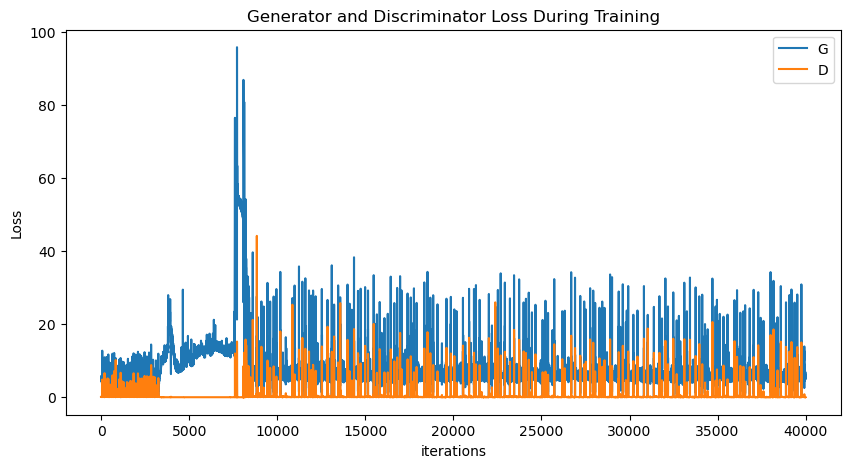

In [18]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generatorLosses,label="G")
plt.plot(discriminatorLosses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21881794 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


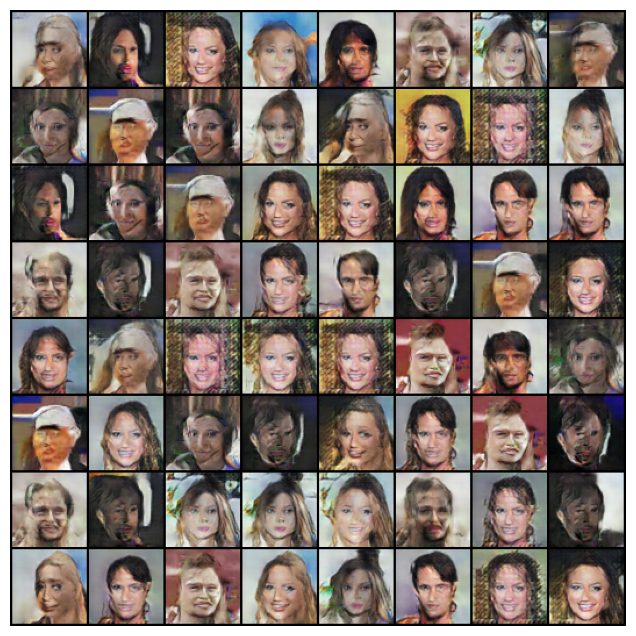

In [19]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in imgList]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [15]:
torch.save(netDiscriminator.state_dict(), "discriminatorModel.pth")

In [16]:
torch.save(netGenerator.state_dict(), "generatorModel.pth")